In [1]:
library(dplyr)
library(data.table)
library(stringr)
library(ggplot2)
library(glue)
library(IRdisplay)
library(Matrix)
library(patchwork)
library(numbat)
library(conos)
library(tidygraph)
library(ggtree)
library(ggpubr)
R.utils::sourceDirectory('~/Numbat/R')


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘data.table’


The following objects are masked from ‘package:dplyr’:

    between, first, last


Registered S3 method overwritten by 'ggtree':
  method      from 
  identify.gg ggfun

Warning message:
“replacing previous import ‘Matrix::expand’ by ‘ggtree::expand’ when loading ‘numbat’”
Loading required package: igraph


Attaching package: ‘igraph’


The following objects are masked from ‘package:dplyr’:

    as_data_frame, groups, union


The following objects are masked from ‘package:stats’:

    decompose, spectrum


The following object is masked from ‘package:base’:

    union



Attaching package: ‘tidygraph’


The following object is masked from ‘package:igraph’:

    groups


The following object is masked from ‘package:stats’:

    filter


ggtree v3.0.4  For

In [722]:
26913 + 29992

[1] 56905

In [574]:
all_samples = c(paste0('ATC', 1:5), paste0('TNBC', 1:5), c('DCIS1'))
cell_counts = cell_annot[all_samples] %>% lapply(nrow) %>% rbind
cell_counts
sum(unlist(cell_counts))

,ATC1,ATC2,ATC3,ATC4,ATC5,TNBC1,TNBC2,TNBC3,TNBC4,TNBC5,DCIS1
,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
.,2203,6226,3264,1731,6144,1097,1034,532,3056,3225,1480


[1] 29992

In [178]:
post_all = lapply(
    all_samples, 
    function(sample) {
        fread(glue('~/paper_data/numbat_out/{sample}_test/clone_post_2.tsv')) %>%
            mutate(sample = sample)
    }) %>%
    bind_rows()

In [578]:
bind_rows(cell_annot[all_samples]) %>% dim

[1] 29992     5

In [580]:
26640 + 29992 + 3246

[1] 59878

In [182]:
sample = 'NCI-N87'
fread(glue('~/paper_data/numbat_out/{sample}_test/clone_post_2.tsv')) %>% dim

[1] 3246   23

In [3]:
cell_annot = fread('~/paper_data/cell_annotations/cell_annot_MDA.tsv') %>%
    mutate(annot = ifelse(cluster.pred == 'T', 'Tumor', 'Normal')) %>%
    split(.$sample)

con_TNBC = readRDS('~/external/MDA/conos_TNBC.rds')
con_ATC = readRDS('~/external/MDA/conos_ATC.rds')

nb = c()

# Collage

## TvN

method,recall,precision,accuracy
<fct>,<dbl>,<dbl>,<dbl>
Numbat,0.970,0.994,0.984
Numbat-exp,0.968,0.991,0.982
CopyKAT,0.969,0.990,0.981


method,recall,precision,accuracy
<fct>,<dbl>,<dbl>,<dbl>
Numbat,0.931,0.993,0.985
Numbat-exp,0.885,0.986,0.980
CopyKAT,0.937,0.988,0.985


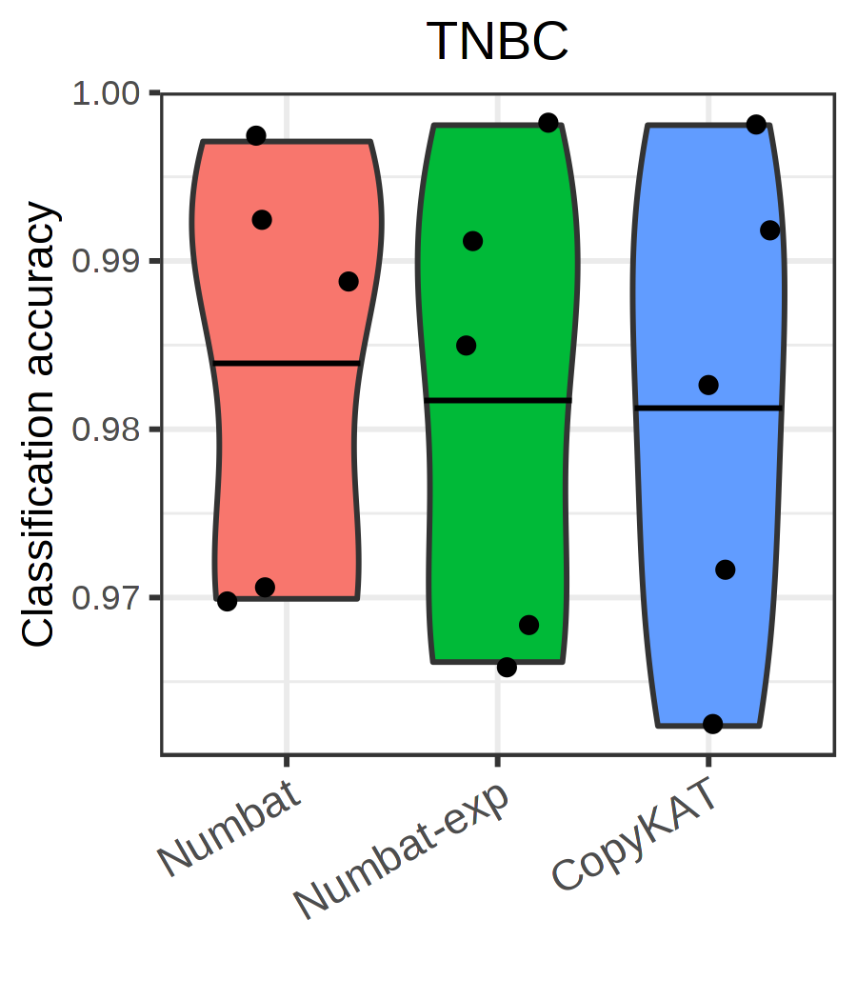

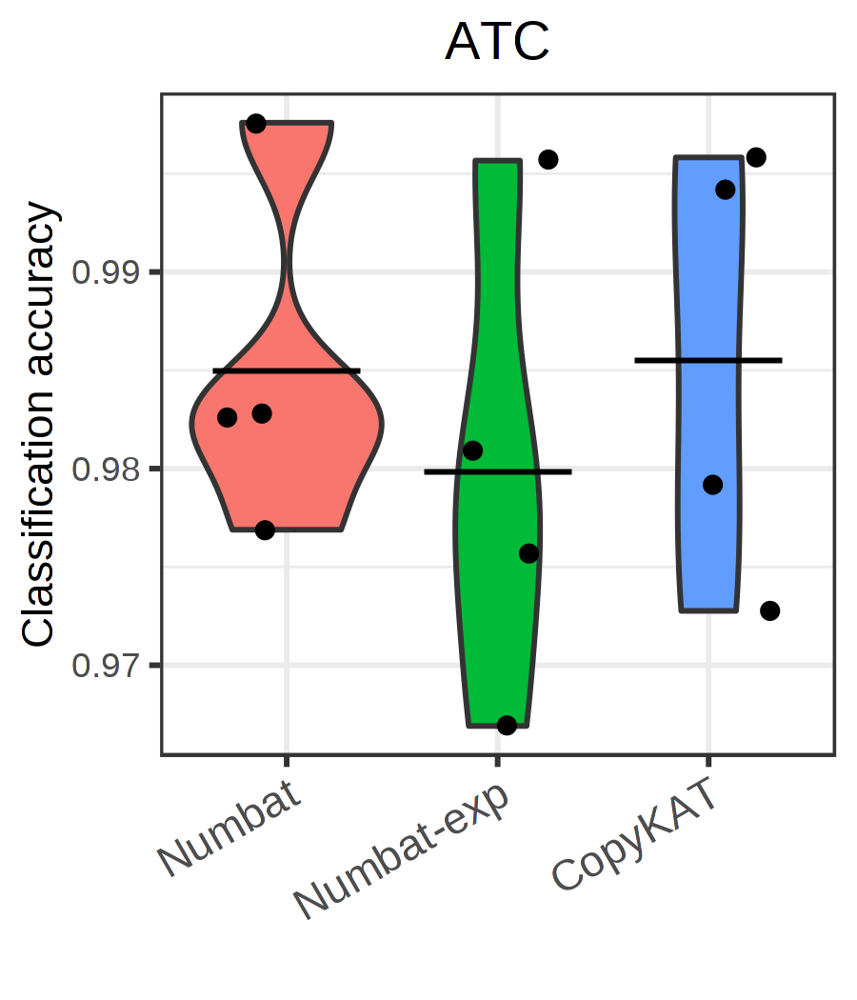

In [4]:
options(repr.plot.width = 3, repr.plot.height = 3.5, repr.plot.res = 300)

datasets = list('TNBC' = paste0('TNBC', 1:5), 'ATC' = paste0('ATC', 1:4))
# datasets = list('ATC' = paste0('ATC', c(1,3:4)))

for (series in names(datasets)) {
    
    clone_post = lapply(
        datasets[[series]], function(sample) {
            fread(glue('~/paper_data/numbat_out/{sample}_test/clone_post_2.tsv'))
        }
    ) %>%
    bind_rows()

    D = clone_post %>% 
        left_join(bind_rows(cell_annot), by = 'cell') %>%
        mutate(
            p_cnv = ifelse(is.na(p_cnv), 1 - p_1, p_cnv),
            numbat.pred = ifelse(p_cnv > 0.5, 'T', 'N'),
            numbat.exp.pred = ifelse(p_cnv_x > 0.5, 'T', 'N'),
            numbat.allele.pred = ifelse(p_cnv_y > 0.5, 'T', 'N')
        ) %>%
        select(copykat.pred, numbat.pred, numbat.exp.pred, numbat.allele.pred, cluster.pred, sample) %>%
        melt(measure.vars = c('numbat.pred', 'copykat.pred', 'numbat.exp.pred'),
             variable.name = 'method',
             value.name = 'pred') %>%
        mutate(method = c(
            'numbat.pred' = 'Numbat', 'numbat.exp.pred' = 'Numbat-exp', 
            'copykat.pred' = 'CopyKAT')[as.character(method)]
        ) %>%
        mutate(method = factor(method, c('Numbat', 'Numbat-exp', 'CopyKAT'))) %>%
        group_by(sample, method) %>%
        summarise(
            recall = mean(pred[cluster.pred == "T"] == "T"),
            precision = mean(cluster.pred[pred == "T"] == "T"),
            accuracy = mean(pred == cluster.pred),
            .groups = 'drop'
        )
    
    set.seed(0)

    p = ggplot(
            D,
            aes(x = method, y = accuracy, fill = method)
        ) +
        geom_violin(
#             draw_quantiles = c(0.5)
        ) +
        geom_jitter() +
        stat_summary(fun=mean, geom="crossbar", size = 0.2, width = 0.7) +
        theme_bw() +
        ylab('Classification accuracy') +
        xlab('') +
        ggtitle(series) +
        theme(
            plot.title = element_text(hjust = 0.5),
            legend.position = 'none',
            axis.text.x = element_text(size = 11, angle = 30, hjust = 1)
        )
    
    do_plot(p, glue('{series}_tvn_scatter'), 3, 3.5)

    D %>%
    group_by(method) %>%
    summarise_at(
        c('recall', 'precision', 'accuracy'),
        function(x){signif(mean(x),3)}
    ) %>%
    display
}

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will rep

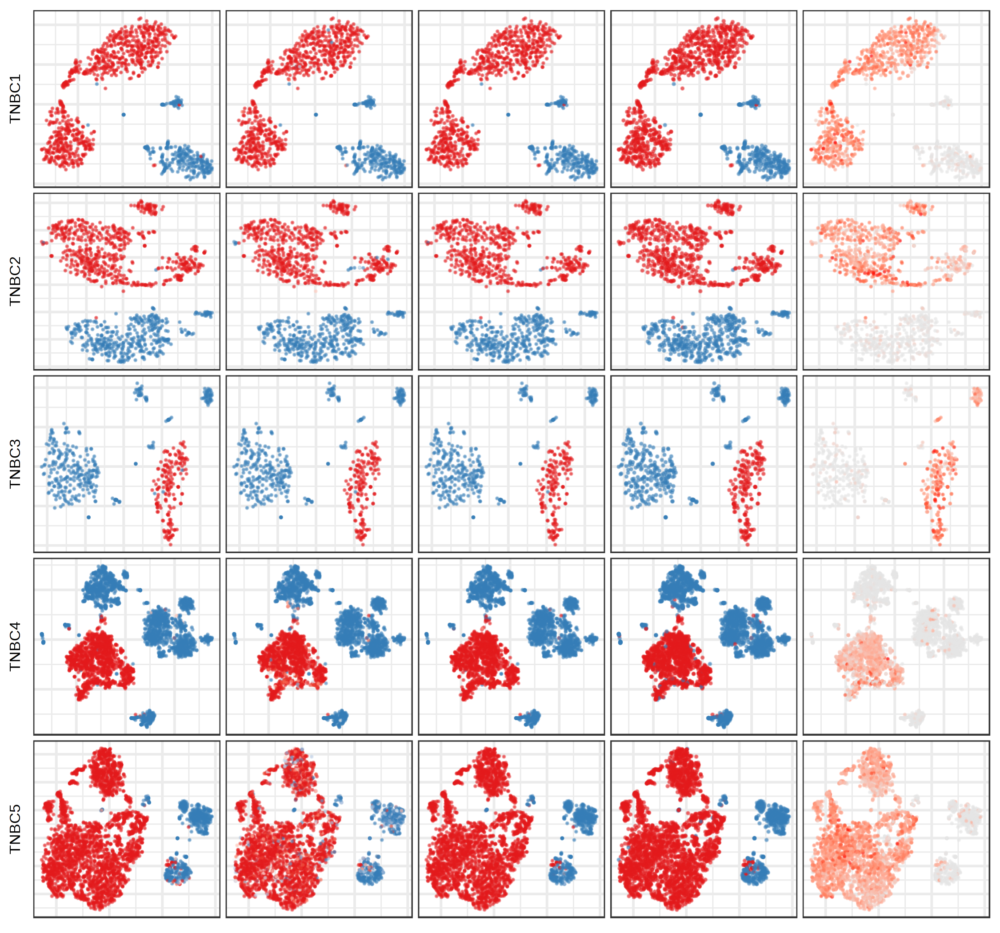

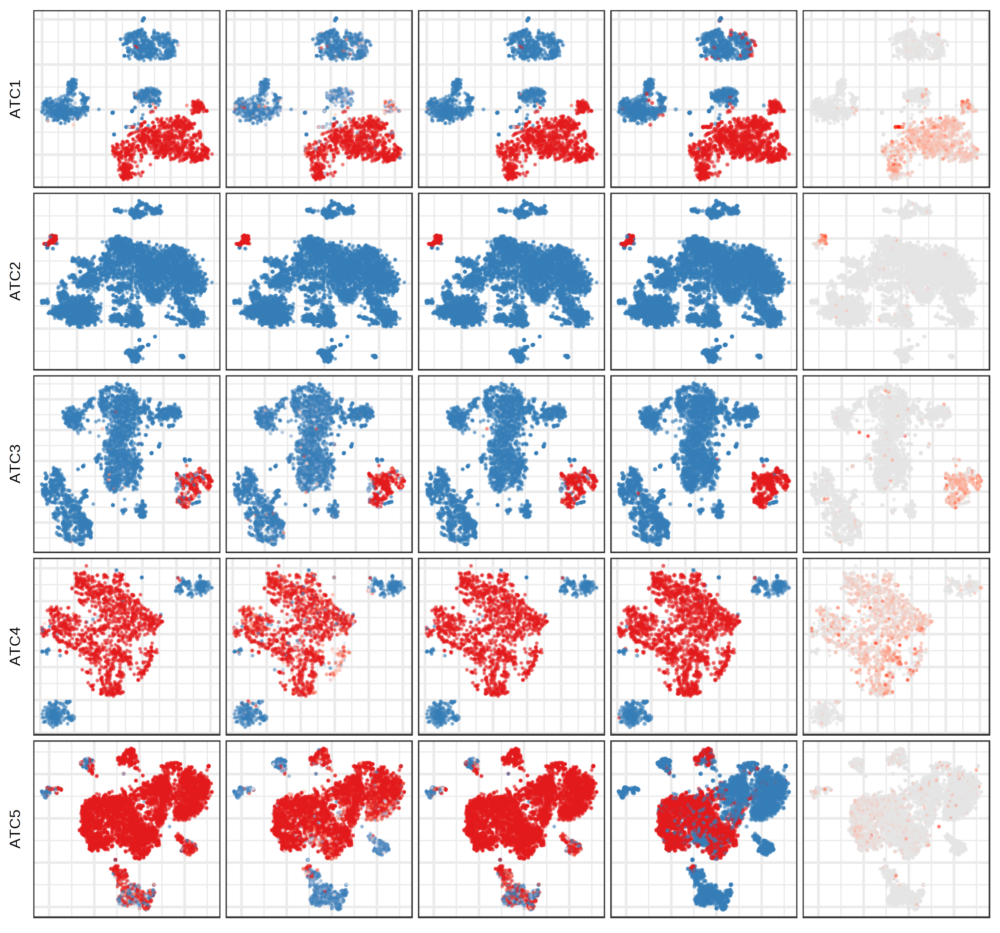

In [9]:
options(repr.plot.width = 7.5, repr.plot.height = 7, repr.plot.res = 300)


datasets = list('TNBC' = paste0('TNBC', 1:5), 'ATC' = paste0('ATC', 1:5))

for (series in names(datasets)) {
    
    joint_plots = list()
    copykat_plots = list()
    exp_plots = list()
    allele_plots = list()
    marker_plots = list()
    
    for (sample in datasets[[series]]) {
        
        if (str_detect(sample, 'ATC')) {
            con = con_ATC
        } else {
            con = con_TNBC
        }

        marker = ifelse(str_detect(sample, 'ATC'), 'KRT8', 'EPCAM')

        clone_post = fread(glue('~/paper_data/numbat_out/{sample}_test/clone_post_2.tsv'))

        cell_clusters = con$samples[[sample]]$clusters$PCA$multilevel
        cell_clusters = cell_clusters[names(cell_clusters) %in% cell_annot[[sample]]$cell]

        marker_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
            alpha=0.5,
            size=0.1, 
            plot.na = F,
            groups = cell_clusters,
            plot.theme = theme_bw(),
            gene = marker,
            raster = TRUE
        ) +
        theme(
            plot.title = element_text(size = 8),
            plot.margin = margin(0,0,0,0)
        )

        exp_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
            alpha=0.5,
            size=0.1, 
            colors = cell_annot[[sample]] %>% 
                left_join(clone_post, by = 'cell') %>%
                {setNames(.$p_cnv_x, .$cell)},
            show.legend = F,
            mark.groups = T,
            plot.na = F,
            plot.theme = theme_bw(),
            raster = TRUE
        ) +
        theme(
            plot.title = element_text(size = 8),
            plot.margin = margin(0,0,0,0),
            axis.title.y = element_text(size = 8)
        ) +
        scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish) +
        ylab(sample)

        allele_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
            alpha=0.5,
            size=0.1, 
            colors = cell_annot[[sample]] %>% 
                left_join(clone_post, by = 'cell') %>%
                {setNames(.$p_cnv_y, .$cell)},
            show.legend = F,
            mark.groups = T,
            plot.na = F,
            plot.theme = theme_bw(),
            raster = TRUE
        #         title = sample,
        ) +
        theme(
            plot.title = element_text(size = 8),
            plot.margin = margin(0,0,0,0)
        ) +
        scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish)

        joint_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
            alpha=0.5,
            size=0.1, 
            colors = cell_annot[[sample]] %>% 
                left_join(clone_post, by = 'cell') %>%
                {setNames(.$p_cnv, .$cell)},
            show.legend = F,
            mark.groups = T,
            plot.na = F,
            plot.theme = theme_bw(),
            raster = TRUE
        ) +
        theme(
            plot.title = element_text(size = 8),
            plot.margin = margin(0,0,0,0)
        ) +
        scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish)


        copykat_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
            alpha=0.5,
            size=0.2, 
            groups = cell_annot[[sample]] %>%
                {setNames(.$copykat.pred, .$cell)},
            show.legend = F,
            mark.groups = F,
            plot.na = F,
            plot.theme = theme_bw(),
            pal = c(pal[2], pal[1]),
            raster = TRUE
        ) +
        theme(
            plot.title = element_text(size = 8),
            plot.margin = margin(0,0,0,0)
        )
        
    }
    
    panel = wrap_plots(c(rbind(exp_plots, allele_plots, joint_plots, copykat_plots, marker_plots)), ncol = 5, byrow = T)

    do_plot(panel, glue('{series}_tvn'), 7.5, 7)
    
}

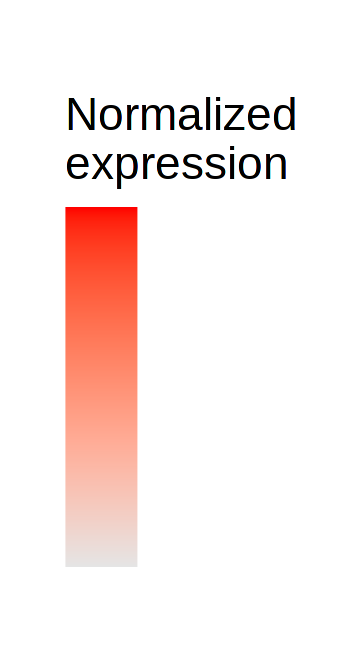

In [80]:
options(repr.plot.width = 3, repr.plot.height = 3, repr.plot.res = 200)

p = con$samples[['TNBC1']]$plotEmbedding(show.legend = TRUE, gene = 'EPCAM') +
    guides(color = guide_colorbar(title = 'Normalized\nexpression', ticks = F, label = FALSE)) 

get_legend(p) %>% as_ggplot %>%
do_plot('exp_legend', 1.2, 2.2)

In [492]:
count_mat_ATC2

[1] 33538   173

In [495]:
cell_annot[['ATC2']] %>% count(cluster.pred)

cluster.pred,n
<chr>,<int>
N,6077
T,149


In [494]:
cell_annot[['ATC2']] %>% count(copykat.pred)

copykat.pred,n
<chr>,<int>
N,6103
T,123


## Phylogenies

In [13]:
nb = list()

In [19]:
for (sample in c(all_samples, 'ATC2_subsampled')) {
    message(sample)
    out_dir = glue('~/paper_data/numbat_out/{sample}_test')
    nb[[sample]] = Numbat$new(out_dir, i = 2)
}

nb[['ATC2']] = nb[['ATC2_subsampled']]

ATC1

Could not read the input file ~/paper_data/numbat_out/ATC1_test/bulk_clones_final.tsv.gz with data.table::fread(). Please check that the file is valid.

ATC2

Could not read the input file ~/paper_data/numbat_out/ATC2_test/bulk_clones_final.tsv.gz with data.table::fread(). Please check that the file is valid.

ATC3

Could not read the input file ~/paper_data/numbat_out/ATC3_test/bulk_clones_final.tsv.gz with data.table::fread(). Please check that the file is valid.

ATC4

Could not read the input file ~/paper_data/numbat_out/ATC4_test/bulk_clones_final.tsv.gz with data.table::fread(). Please check that the file is valid.

ATC5

Could not read the input file ~/paper_data/numbat_out/ATC5_test/bulk_clones_final.tsv.gz with data.table::fread(). Please check that the file is valid.

TNBC1

TNBC2

Could not read the input file ~/paper_data/numbat_out/TNBC2_test/bulk_clones_final.tsv.gz with data.table::fread(). Please check that the file is valid.

TNBC3

Could not read the input file 

In [20]:
nb[['ATC2']] = nb[['ATC2_subsampled']]

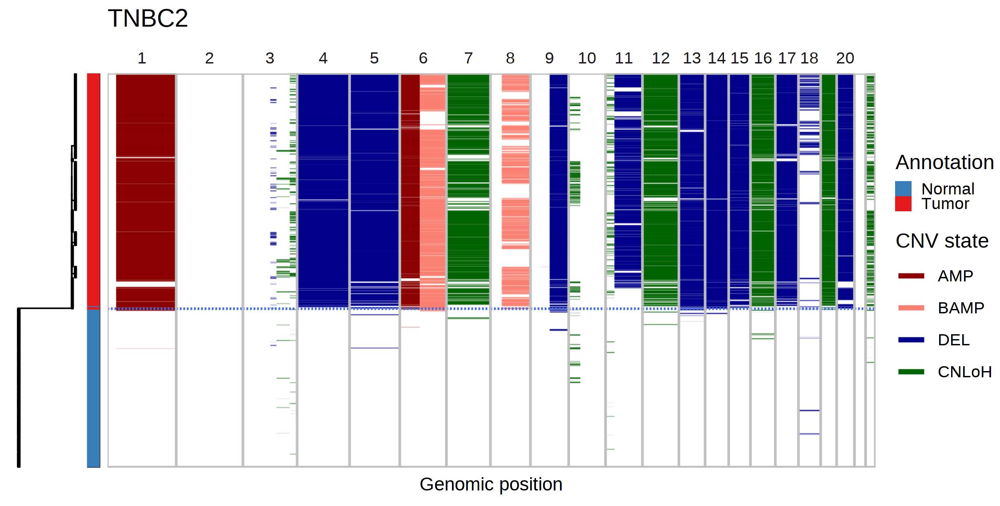

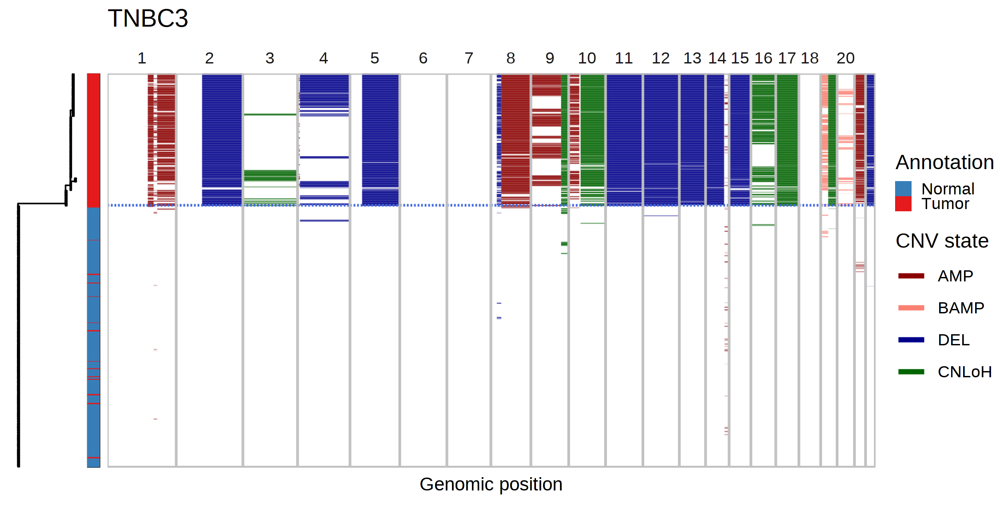

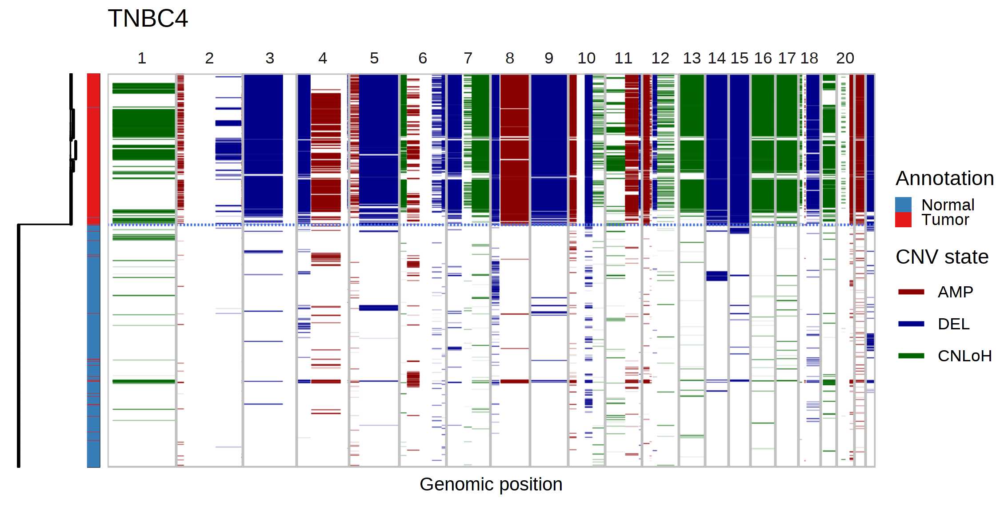

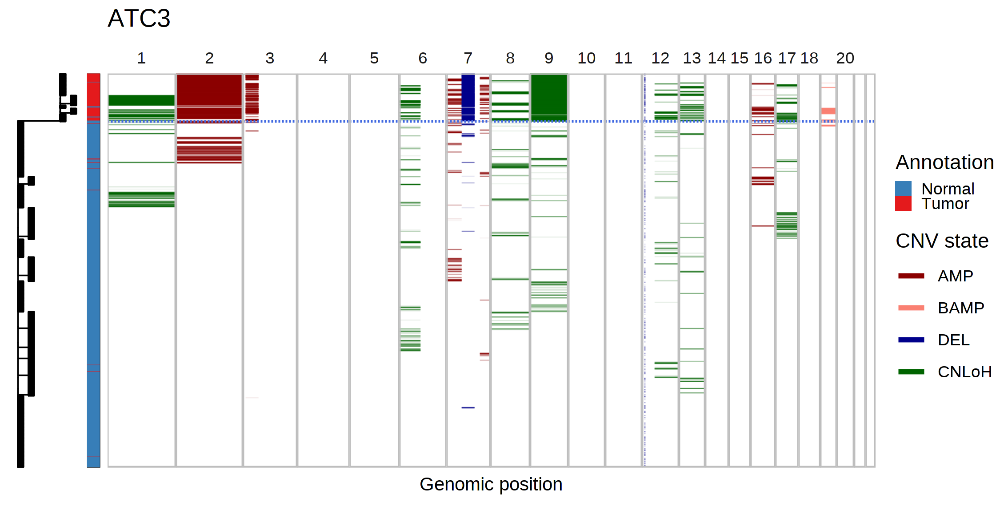

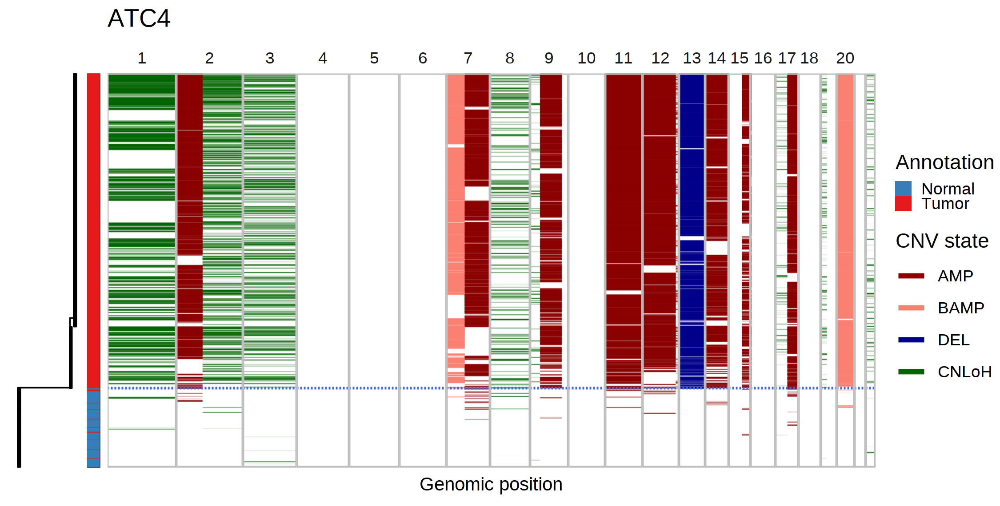

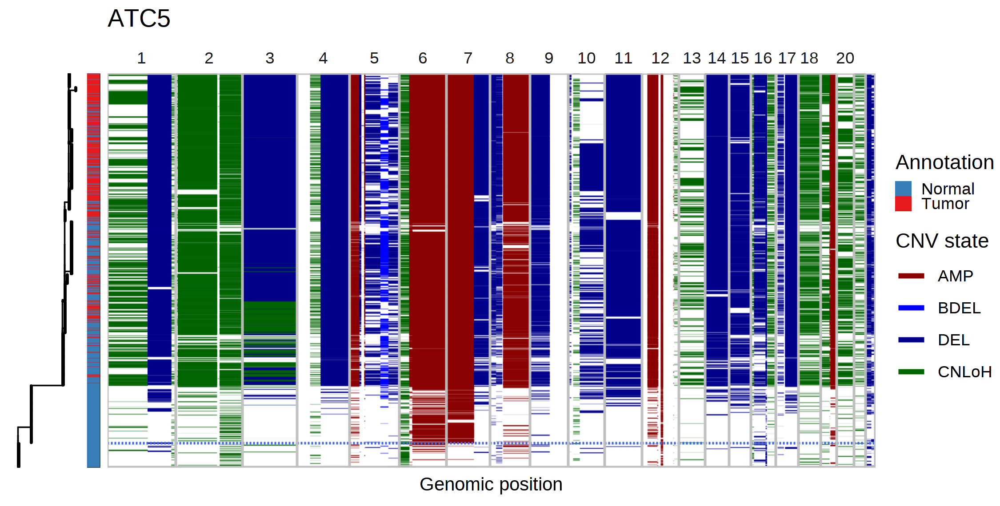

In [37]:
options(repr.plot.width = 7.5, repr.plot.height = 3.8, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

for (sample in c('TNBC2', 'TNBC3', 'TNBC4', 'ATC3', 'ATC4', 'ATC5')) {
    
    p = nb[[sample]]$plot_phylo_heatmap(
        annot = cell_annot[[sample]] %>% {setNames(.$annot, .$cell)},
        clone_legend = F,
        tip_length = 0.5,
#         tip_length = 0.1,
        branch_width = 0.3,
        line_width = 0.15,
        tree_height = 1.25,
        pal_annot = c(pal[2], pal[1]),
        raster = TRUE
    ) + ggtitle(sample) &
    theme(plot.background = element_rect(fill = "transparent", color = NA))
    
    do_plot(p, glue("{sample}_phylogeny"), w = 7.5, h = 3.8)
}

# mtRNA

In [10]:
mt_samples = c('TNBC1', 'TNBC2', 'TNBC5', 'ATC1', 'ATC2_subsampled')
samples = c(paste0('TNBC',1:5), 'ATC2_subsampled', 'ATC1', paste0('ATC', 3:5))

for (sample in samples) {
    message(sample)
    out_dir = glue('~/paper_data/numbat_out/{sample}_test')
    nb[[sample]] = Numbat$new(out_dir, i = 2)
}

nb[['ATC2']] = nb[['ATC2_subsampled']] 

TNBC1

TNBC2

Could not read the input file ~/paper_data/numbat_out/TNBC2_test/bulk_clones_final.tsv.gz with data.table::fread(). Please check that the file is valid.

TNBC3

Could not read the input file ~/paper_data/numbat_out/TNBC3_test/bulk_clones_final.tsv.gz with data.table::fread(). Please check that the file is valid.

TNBC4

Could not read the input file ~/paper_data/numbat_out/TNBC4_test/bulk_clones_final.tsv.gz with data.table::fread(). Please check that the file is valid.

TNBC5

Could not read the input file ~/paper_data/numbat_out/TNBC5_test/bulk_clones_final.tsv.gz with data.table::fread(). Please check that the file is valid.

ATC2_subsampled

Could not read the input file ~/paper_data/numbat_out/ATC2_subsampled_test/bulk_clones_final.tsv.gz with data.table::fread(). Please check that the file is valid.

ATC1

Could not read the input file ~/paper_data/numbat_out/ATC1_test/bulk_clones_final.tsv.gz with data.table::fread(). Please check that the file is valid.

ATC3

Cou

In [23]:
VAF = list()

for (sample in c('TNBC1', 'TNBC2', 'TNBC5', 'ATC1', 'ATC2')) {
    AD = readMM(glue('~/paper_data/mtRNA/mquad/{sample}/passed_ad.mtx')) %>% as.matrix
    DP = readMM(glue('~/paper_data/mtRNA/mquad/{sample}/passed_dp.mtx')) %>% as.matrix
    cells = fread(glue('~/external/MDA/{sample}_barcodes.tsv'), header = F)$V1
    cells = paste0(sample, '_', cells)
    variants = fread(glue('~/paper_data/mtRNA/mquad/{sample}/passed_variant_names.txt'), header = F)$V1
    VAF[[sample]] = AD/DP
    colnames(VAF[[sample]]) = cells
    rownames(VAF[[sample]]) = variants
    colnames(DP) = cells
    rownames(DP) = variants
    
    VAF[[sample]] = VAF[[sample]] %>%
        reshape2::melt() %>% 
        setNames(c('variant', 'cell', 'VAF')) %>%
        left_join(
            DP %>%
                reshape2::melt() %>% 
                setNames(c('variant', 'cell', 'DP')),
            by = c("variant", "cell")
        )
}

In [24]:
clones = lapply(
     c('TNBC1', 'ATC2', 'TNBC5', 'ATC1'),
    function(sample) {
        if (sample == 'TNBC5') {
            clones = nb[[sample]]$clone_post %>%
                mutate(clone_opt = case_when(
                    clone_opt == 1 ~ 'Normal',
                    clone_opt %in% 2 ~ 'Truncal',
                    clone_opt %in% 7:15 ~ 'Major',
                    clone_opt %in% 3:6 ~ 'Minor'
                ))
        } else if (sample %in% 'ATC1') {
            clones = nb[[sample]]$clone_post %>%
                mutate(clone_opt = case_when(
                    clone_opt == 1 ~ 'Normal',
                    clone_opt %in% 2 ~ 'Truncal',
                    clone_opt %in% 4 ~ 'Major',
                    clone_opt %in% 3 ~ 'Minor'
                ))
        } else if (sample == 'TNBC1') {
            clones = nb[[sample]]$clone_post %>%
                mutate(clone_opt = case_when(
                    clone_opt == 1 ~ 'Normal',
                    clone_opt %in% 2 ~ 'Truncal',
                    clone_opt %in% 4 ~ 'Major',
                    clone_opt %in% 3 ~ 'Minor'
                ))
        } else {
            clones = nb[['ATC2_subsampled']]$clone_post %>%
                mutate(clone_opt = case_when(
                    clone_opt == 1 ~ 'Normal',
                    T ~ as.character(as.integer(as.factor(clone_opt))-1)
                ))
        }
        clones = clones %>% mutate(sample = sample)
    }
) %>% 
bind_rows()

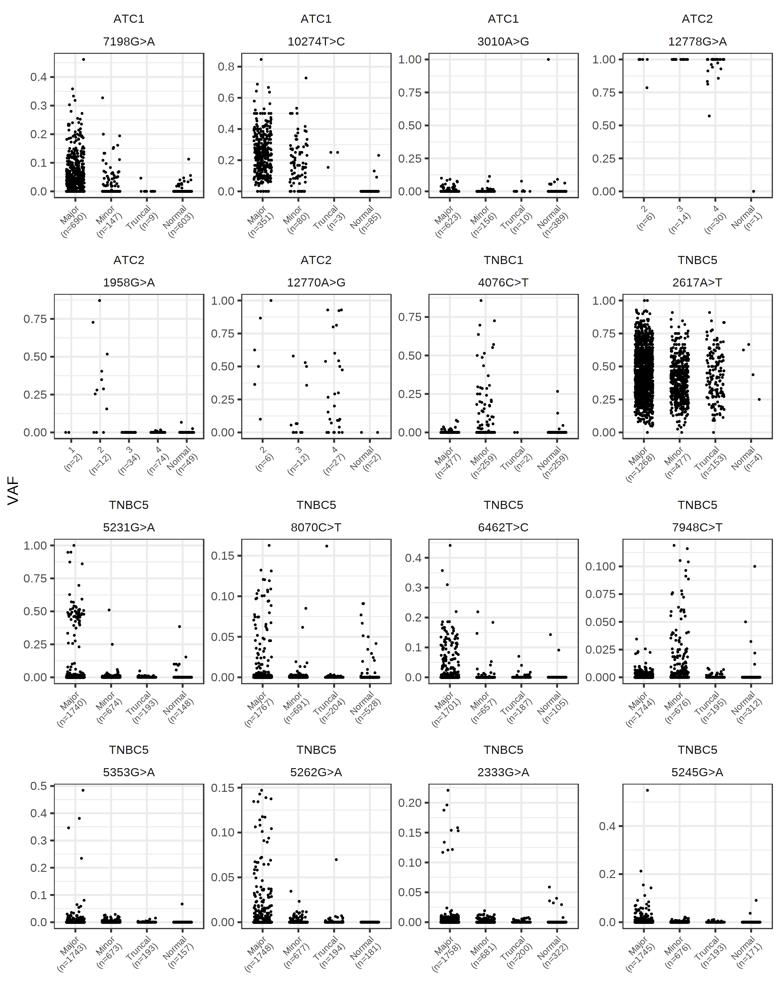

In [200]:
p = bind_rows(VAF) %>% 
    left_join(
        bind_rows(cell_annot),
        by = 'cell'
    ) %>%
    inner_join(
        clones,
        by = c('cell', 'sample')
    ) %>%
    group_by(variant, sample) %>%
    filter(sum(VAF[cluster.pred == 'T'] > 0.05, na.rm = T) > 5) %>%
    filter(DP >= 10) %>%
    group_by(variant, clone_opt, sample) %>%
    mutate(clone_opt = paste0(clone_opt, '\n(n=', n(), ')')) %>%
    ungroup() %>%
    arrange(sample, str_detect(clone_opt, 'Normal'), clone_opt) %>%
    mutate(clone_opt = factor(clone_opt, unique(clone_opt))) %>%
    ggplot(
        aes(x = clone_opt, y = VAF)
    ) +
    geom_jitter(size = 0.1, width = 0.25) +
    theme_bw() +
    theme(
        strip.background = element_blank(),
        axis.text.x = element_text(angle = 45, hjust = 1, vjust = 1, size = 6.5)
    ) +
    facet_wrap(~sample+variant, scale = 'free') +
    xlab('')

do_plot(p, 'mt_vafs', 8, 10.25)

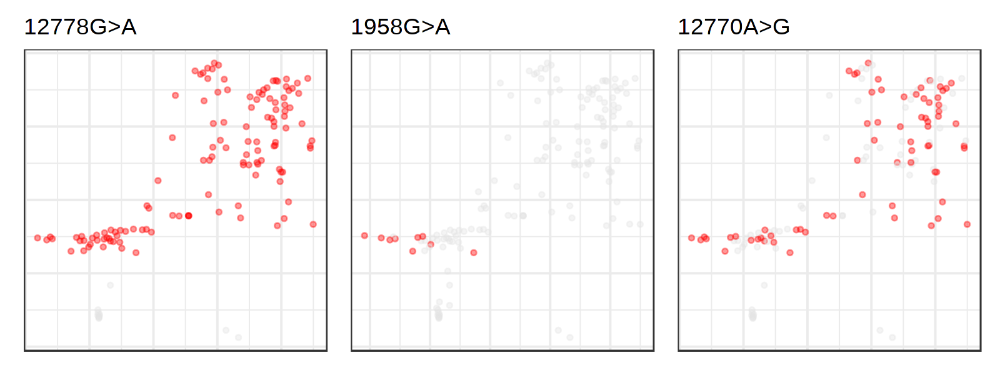

In [319]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)

sample = 'ATC2'

cells = cell_annot[[sample]] %>% filter(cluster.pred == 'T') %>% pull(cell)

lapply(
    VAF[[sample]] %>% 
        filter(cell %in% cells) %>%
        group_by(variant) %>%
        filter(sum(VAF > 0.15, na.rm = T) > 3) %>%
        ungroup() %>%
        mutate(variant = factor(variant)) %>%
        split(.$variant),
    function(VAF) {
        con_ATC$samples[[sample]]$plotEmbedding(
            colors = VAF %>% {setNames(as.integer(.$VAF > 0.1), .$cell)},
            plot.na = F,
            size = 1,
            title = unique(VAF$variant)
        )
    }
) %>% 
wrap_plots()

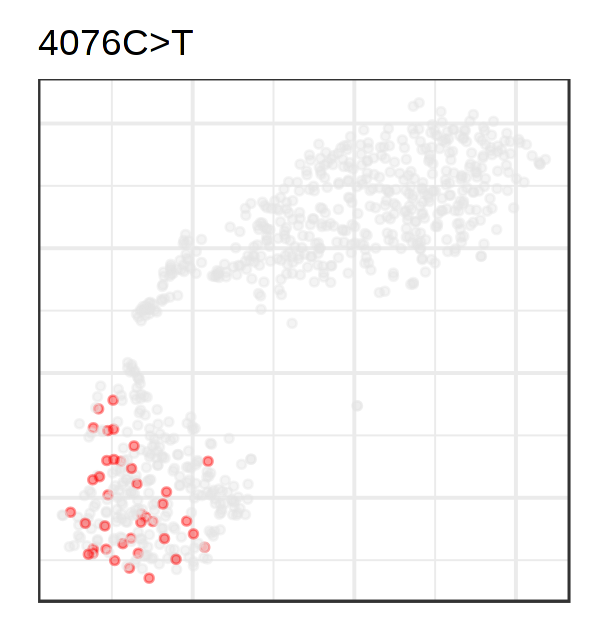

In [317]:
options(repr.plot.width = 3, repr.plot.height = 3.2, repr.plot.res = 200)

sample = 'TNBC1'

cells = cell_annot[[sample]] %>% filter(cluster.pred == 'T') %>% pull(cell)

lapply(
    VAF[[sample]] %>% 
        filter(cell %in% cells) %>%
        group_by(variant) %>%
        filter(sum(VAF > 0.15, na.rm = T) > 3) %>%
        ungroup() %>%
        mutate(variant = factor(variant)) %>%
        split(.$variant),
    function(VAF) {
        con_TNBC$samples[[sample]]$plotEmbedding(
            colors = VAF %>% {setNames(as.integer(.$VAF > 0.1), .$cell)},
            plot.na = F,
            size = 1,
            title = unique(VAF$variant)
        )
    }
) %>% 
wrap_plots()

In [784]:
sample = 'ATC1'

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



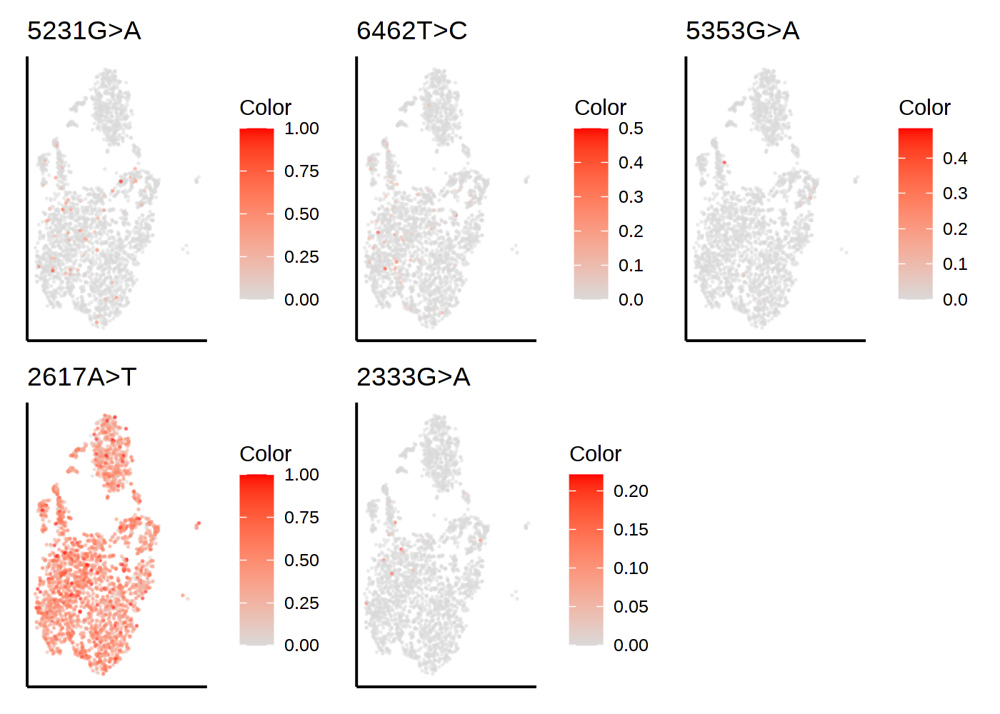

In [216]:
options(repr.plot.width = 7, repr.plot.height = 5, repr.plot.res = 200)

sample = 'TNBC5'
cells = cell_annot[[sample]] %>% filter(cluster.pred == 'T') %>% pull(cell)

lapply(
    VAF[[sample]] %>% 
        filter(cell %in% cells) %>%
        group_by(variant) %>%
        filter(sum(VAF > 0.15, na.rm = T) > 3) %>%
        ungroup() %>%
        mutate(variant = factor(variant)) %>%
        split(.$variant),
    function(VAF) {
        con_TNBC$samples[[sample]]$plotEmbedding(
            colors = VAF %>% {setNames(.$VAF, .$cell)},
            plot.na = F,
            size = 0.05,
            title = unique(VAF$variant),
            plot.theme = theme_classic(),
            show.legend = T
        ) +
        scale_color_gradient(low = 'gray85', high = 'red')
    }
) %>% 
wrap_plots()

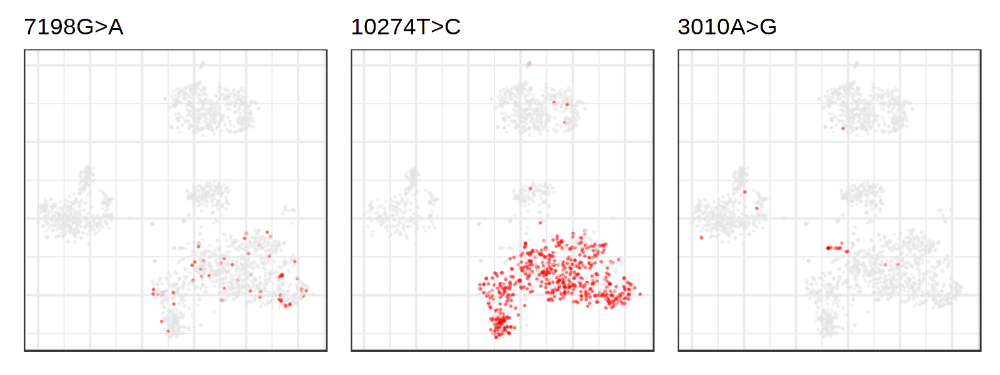

In [217]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)

sample = 'ATC1'

lapply(
    VAF[[sample]] %>% 
        group_by(variant) %>%
        filter(sum(VAF > 0.1, na.rm = T) > 3) %>%
        ungroup() %>%
        mutate(variant = factor(variant)) %>%
        split(.$variant),
    function(VAF) {
        con_ATC$samples[[sample]]$plotEmbedding(
            colors = VAF %>% {setNames(as.integer(.$VAF > 0.15), .$cell)},
            plot.na = F,
            size = 0.1,
            title = unique(VAF$variant)
        )
    }
) %>% 
wrap_plots()

# Calling clones

In [2329]:
all_samples = c('ATC1', 'ATC2_subsampled', paste0('ATC', 3:5), paste0('TNBC', 1:5), c('DCIS1'))

for (sample in all_samples) {
    message(sample)
    out_dir = glue('~/paper_data/numbat_out/{sample}_test')
    nb[[sample]] = Numbat$new(out_dir, i = 2, old_index = FALSE)
}

ATC1

ATC2_subsampled

ATC3

ATC4

ATC5

TNBC1

TNBC2

TNBC3

TNBC4

TNBC5

DCIS1



In [1341]:
R.utils::sourceDirectory('~/Numbat/R')

for (sample in samples) {
    
    message(sample)
    
    nb[[sample]]$gtree = nb[[sample]]$gtree %>% annot_superclones(nb[[sample]]$geno, precision_cutoff = 0.9)

    superclone_dict = nb[[sample]]$gtree %>% as.data.frame() %>% count(GT, superclone) %>% {setNames(.$superclone, .$GT)}

    nb[[sample]]$mut_graph = nb[[sample]]$mut_graph %>%
        as_tbl_graph %>% 
        mutate(superclone = superclone_dict[GT]) %>%
        mutate(superclone = ifelse(is.na(superclone), 1, superclone)) %>%
        mutate(clone = superclone)
    
}

TNBC1

TNBC2

TNBC3

TNBC4

TNBC5

ATC2_subsampled

ATC1

ATC3

ATC4

ATC5



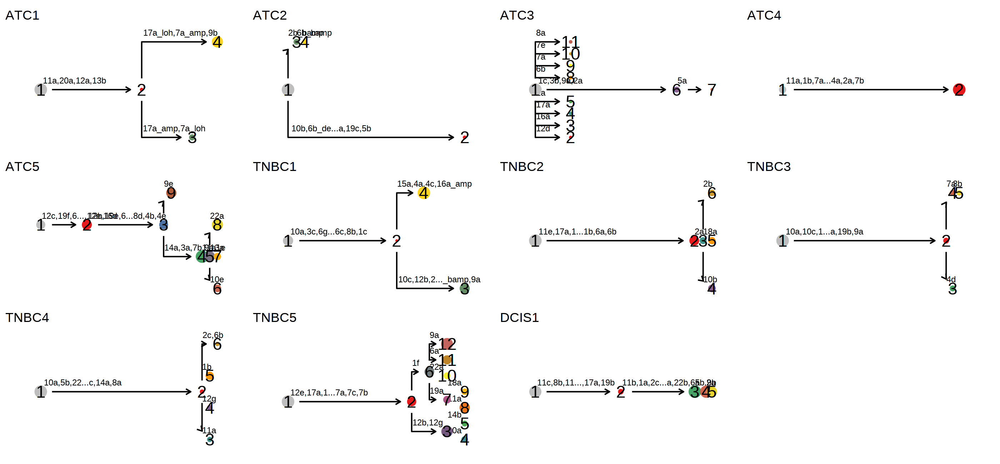

In [832]:
options(repr.plot.width = 14, repr.plot.height = 6.5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

lapply(
    all_samples,
    function(sample) {
        nb[[sample]]$plot_mut_history(edge_label_size = 3, node_size = 5, legend = FALSE) + ggtitle(sample)
}) %>% 
wrap_plots(nrow = 3)

In [53]:
nb = list()

In [54]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC2'
out_dir = glue('~/paper_data/numbat_out/{sample}_new')
nb[[sample]] = Numbat$new(out_dir, i = 2)

In [2291]:
gtree = nb[[sample]]$gtree
P = 1-nb[[sample]]$geno

In [2356]:
get_desc = function(gtree, v) {
    
    cells = gtree %>%
        activate(nodes) %>%
        mutate(seq = bfs_rank(root = v)) %>%
        filter(!is.na(seq) & leaf) %>%
        pull(name)
    
    return(cells)
    
}

score_branches = function(gtree, P) {
    
    L = log(P/(1-P))
            
    mut_nodes = gtree %>% activate(nodes) %>% as.data.frame %>%
        filter(!is.na(site)) %>%
        tidyr::separate_rows(site, sep = ',') %>%
        select(node = id, site)

    scores = mut_nodes %>% 
        rowwise() %>%
        mutate(LLR = sum(L[get_desc(gtree, node),site]))
    
    return(scores)
    
}

compute_w = function(P, cells_1, cells_2) {
    sum((colMeans(P[cells_1,]) - colMeans(P[cells_2,]))^2)
}

compute_z = function(P, cells_1, cells_2) {
    N = length(c(cells_1, cells_2))
    n = length(cells_1)
    m = length(cells_2)
    sigma = sqrt(apply(P[c(cells_1, cells_2),], 2, 'var'))
    sigma_d = sqrt((sigma^2/n)*((N-n)/(N-1)) + (sigma^2/m)*((N-m)/(N-1)))
    sum((colMeans(P[cells_1,]) - colMeans(P[cells_2,]))^2/sigma_d^2)
}

compute_d = function(P, cells_1, cells_2) {
    sum(abs(colMeans(P[cells_1,]) - colMeans(P[cells_2,])))
}

permute_d = function(P, cells_1, cells_2, n = 1000) {
    P = P[rownames(P) %in% c(cells_1, cells_2),]
    replicate(n = n, {
        rownames(P) = sample(rownames(P))
        d = compute_d(P, cells_1, cells_2)
    })
}

permute_w = function(P, cells_1, cells_2, n = 1000) {
    P = P[rownames(P) %in% c(cells_1, cells_2),]
    replicate(n = n, {
        rownames(P) = sample(rownames(P))
        w = compute_w(P, cells_1, cells_2)
    })
}

p_w = function(gtree, P, from_node, to_node, sites = NULL, n = 1000, plot = FALSE) {
    
    gtree = gtree %>% activate(nodes)
    
    # from root
    if (is.na(from_node)) {
        from_node = gtree %>% filter(root) %>% pull(name)
    }
    
    from_node = gtree %>% filter(name == from_node) %>% pull(id)
    to_node = gtree %>% filter(name == to_node) %>% pull(id)
    
    cells_1 = get_desc(gtree, from_node)
    cells_2 = get_desc(gtree, to_node)

    cells_1 = cells_1[!cells_1 %in% cells_2]
    
    z = compute_z(P, cells_1, cells_2)
    d = compute_d(P, cells_1, cells_2)
    
    return(tibble(z, d))
}

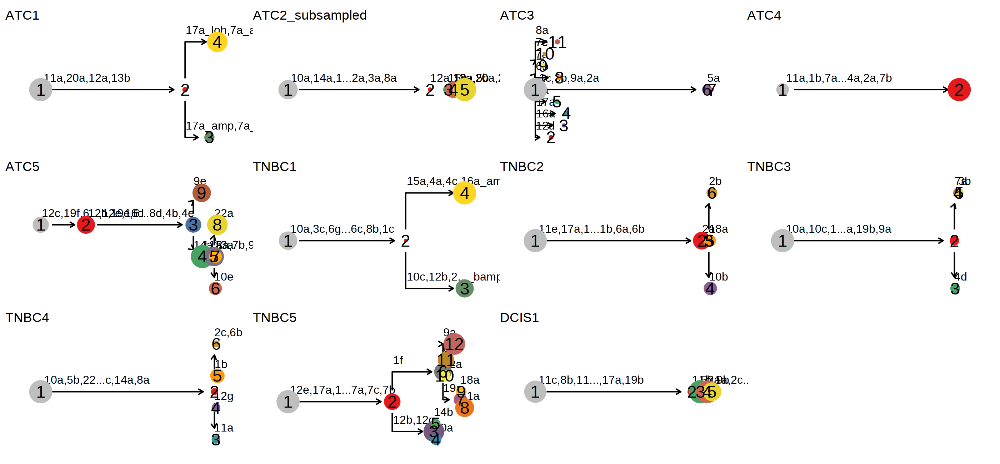

In [1602]:
options(repr.plot.width = 14, repr.plot.height = 6.5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plots = lapply(
    all_samples,
    function(sample) {
        P = nb[[sample]]$geno
        gtree = nb[[sample]]$gtree
        G = nb[[sample]]$mut_graph

        edge_scores = G %>% igraph::as_data_frame('edges') %>%
            rowwise() %>%
            mutate(p_w(gtree, P, from_node, to_node, to_label, plot = FALSE, n = 10)) %>%
            ungroup() %>%
            mutate(rank = rank(-z))

    #     E(G)$to_label = edge_scores$rank

        E(G)$length = edge_scores$z

        G %>% plot_mut_history(clone_post = nb[[sample]]$clone_post, show_distance = TRUE, legend = F) + ggtitle(sample)
    }
)

wrap_plots(plots)

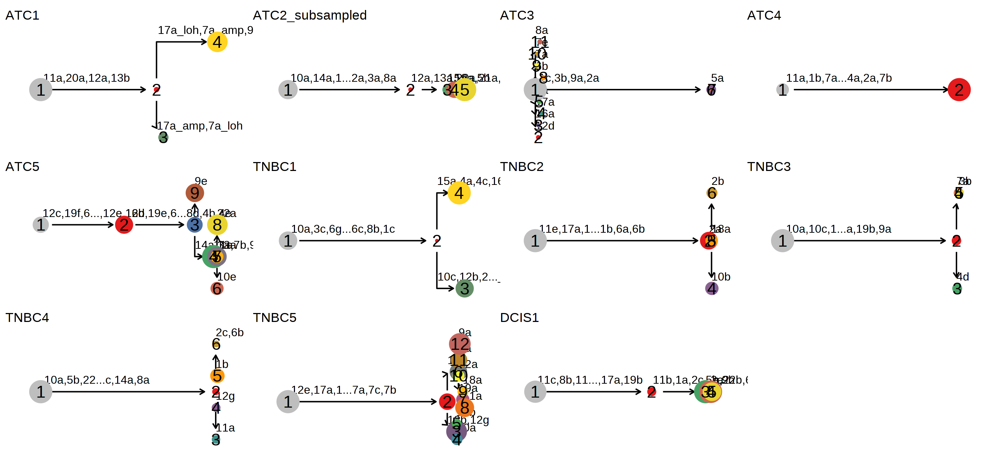

In [2355]:
options(repr.plot.width = 14, repr.plot.height = 6.5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plots = lapply(
    all_samples,
    function(sample) {

        P = 1-nb[[sample]]$geno
        gtree = nb[[sample]]$gtree
        G = nb[[sample]]$mut_graph

        site_scores = score_branches(gtree, P) %>% {setNames(.$LLR, .$site)}
    
        edge_scores = G %>% igraph::as_data_frame('edges') %>%
            rowwise() %>%
            mutate(LLR = sum(site_scores[unlist(str_split(to_label, ','))]))

    #     E(G)$to_label = edge_scores$rank

        E(G)$length = edge_scores$LLR

        G %>% plot_mut_history(clone_post = nb[[sample]]$clone_post, show_distance = TRUE, legend = F) + ggtitle(sample)
    }
)

wrap_plots(plots)

# DCIS1

In [55]:
sample = 'DCIS1'
nb[[sample]] = Numbat$new(glue('~/paper_data/numbat_out/{sample}'), i = 2)

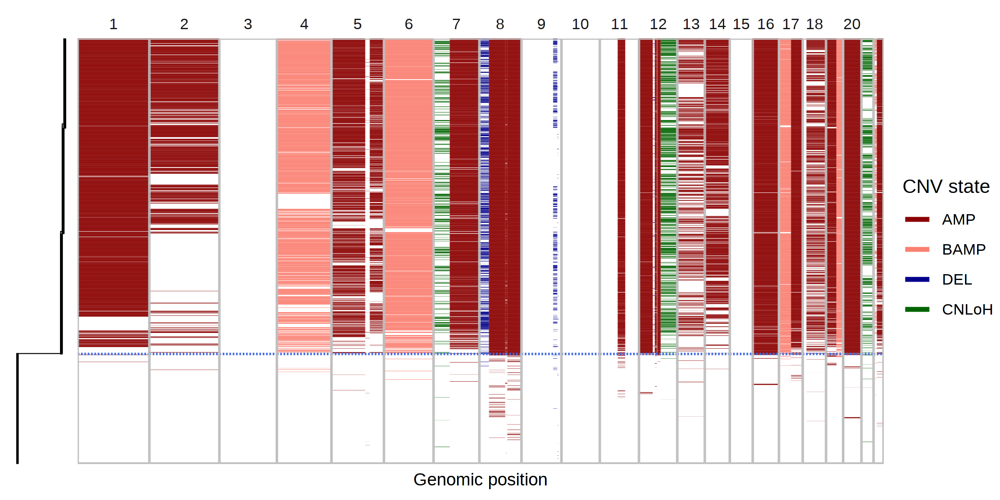

In [130]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'DCIS1'

nb[[sample]]$plot_phylo_heatmap(
    tip_length = 1,
    branch_width = 0.2,
    line_width = 0.075,
    p_min = 0.9
)

In [302]:
sample = 'DCIS1'

copykat.cna = fread('~/paper_data/copykat_out/DCIS1_orig/DCIS1_copykat_CNA_results.txt') %>%
    rename(CHROM = chrom, POS = chrompos)

copykat.pred = fread('~/paper_data/copykat_out/DCIS1_orig/DCIS1_copykat_prediction.txt') %>% 
    rename(cell = cell.names, pred = copykat.pred)

copykat.cna.long = copykat.cna %>% 
    filter(CHROM != 23) %>%
    reshape2::melt(id.var = c('CHROM', 'POS'), variable.name = 'cell', value.name = 'score') %>%
    mutate(cell = str_replace(cell, '\\.', '-')) %>%
    left_join(copykat.pred, by = 'cell')

In [298]:
library(copykat)

out_dir = '~/paper_data/copykat_out/DCIS1_orig'

dir.create(out_dir, recursive = TRUE, showWarnings = TRUE)
setwd(out_dir)

copykat.test <- copykat(
    rawmat = as.matrix(count_mat), 
    id.type="S", 
    sam.name='DCIS1', 
    distance="euclidean", 
    n.cores=30
)

Warning message in dir.create(out_dir, recursive = TRUE, showWarnings = TRUE):
“'/home/tenggao/paper_data/copykat_out/DCIS1_orig' already exists”


[1] "running copykat v1.0.8 updated 02/25/2022 introduced mm10 module, fixed typos"
[1] "step1: read and filter data ..."
[1] "33694 genes, 1480 cells in raw data"
[1] "11541 genes past LOW.DR filtering"
[1] "step 2: annotations gene coordinates ..."
[1] "start annotation ..."
[1] "step 3: smoothing data with dlm ..."
[1] "step 4: measuring baselines ..."
number of iterations= 490 
number of iterations= 152 
number of iterations= 274 
number of iterations= 174 
number of iterations= 720 
number of iterations= 3185 
[1] "step 5: segmentation..."
[1] "step 6: convert to genomic bins..."
[1] "step 7: adjust baseline ..."
[1] "step 8: final prediction ..."
[1] "step 9: saving results..."
[1] "step 10: ploting heatmap ..."
Time difference of 4.4821 mins


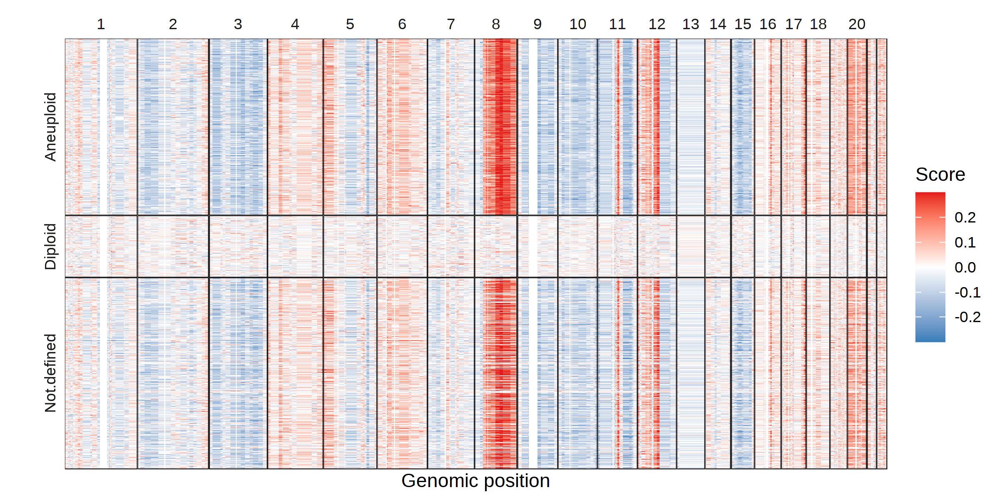

In [303]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 300)

chrom_labeller <- function(chr){
        # chr[as.integer(chr) %% 2 == 0] = ''
        chr[chr %in% c(19, 21, 22)] = ''
        return(chr)
    }

copykat.cna.long %>%
filter(!is.na(pred)) %>%
# filter(cell %in% sample(unique(cell), 50)) %>%
mutate(pred = str_to_title(pred)) %>%
ggplot(
    aes(x = POS, y = cell, fill = score)
) +
xlab('Genomic position') +
ylab('') +
geom_tile() +
theme_classic() +
scale_y_discrete(expand = expansion(0)) +
scale_x_discrete(expand = expansion(add = 0.5)) +
theme(
    panel.spacing = unit(0.1, 'mm'),
    axis.line.x = element_blank(),
    axis.line.y = element_blank(),
    axis.ticks = element_blank(),
    panel.border = element_rect(color = 'black', size = 0.2, fill = NA),
    panel.background = element_rect(fill = 'white'),
    strip.background = element_blank(),
    axis.text = element_blank(),
    strip.text = element_text(angle = 0)
) +
scale_fill_gradient2(low = pal[2], high = pal[1], midpoint = 0, limits = c(-0.3, 0.3), oob = scales::oob_squish, name = 'Score') +
facet_grid(pred~CHROM, scale = 'free', space = 'free', labeller = labeller(CHROM = chrom_labeller), switch = 'y')

### CNV Color legend

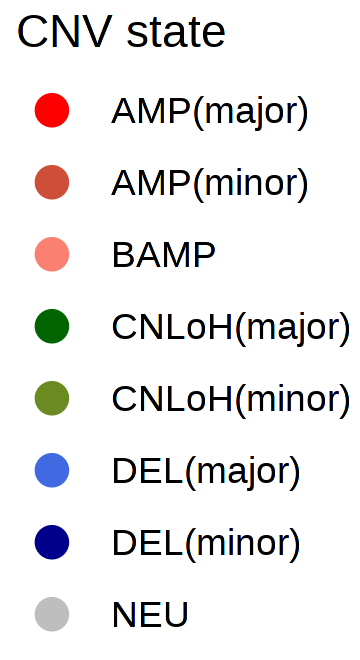

In [108]:
options(repr.plot.width = 1.2, repr.plot.height = 2.2, repr.plot.res = 300)

p = data.frame(
    state = c('AMP_up', 'AMP_down', 'DEL_up', 'DEL_down', 'CNLoH_up', 'CNLoH_down', 'NEU', 'BAMP')
) %>%
mutate(
    state = state %>% str_replace('_up', '(major)') %>% 
        str_replace('_down', '(minor)')
) %>%
ggplot(
    aes(x = state, y = state, color = state)
) +
geom_point() +
scale_color_manual(
    values = setNames(cnv_colors, names(cnv_colors) %>% 
        str_replace('_up', '(major)') %>% 
        str_replace('_down', '(minor)') %>%
        str_replace('loh', 'CNLoH') %>%
        str_replace('bamp', 'BAMP') %>%
        str_replace('amp', 'AMP') %>%
        str_replace('del', 'DEL') %>%
        str_replace('neu', 'NEU')
    ),
    limits = force
) +
theme_classic() +
guides(color = guide_legend(override.aes = aes(size = 3), title = 'CNV state'))

get_legend(p) %>% as_ggplot %>%
do_plot('cnv_legend', 1.2, 2.2)

In [44]:
sample = 'DCIS1'

In [481]:
copykat.cna = fread('~/paper_data/copykat_out/DCIS1/DCIS1_copykat_CNA_results.txt') %>%
    rename(CHROM = chrom, POS = chrompos)

colnames(copykat.cna) = str_replace(colnames(copykat.cna), '\\.', '-')

In [482]:
tumor_cells = cell_annot[['DCIS1']] %>% filter(cluster.pred == 'T') %>% pull(cell)
normal_cells = cell_annot[['DCIS1']] %>% filter(cluster.pred == 'N') %>% pull(cell)
copykat.cna$score_avg = rowMeans(as.matrix(copykat.cna)[,cells])

In [483]:
copykat.segs = copykat.cna %>% 
    arrange(CHROM, POS) %>%
    mutate(boundary = c(0, score_avg[2:length(score_avg)] != score_avg[1:(length(score_avg)-1)])) %>%
    group_by(CHROM) %>%
    mutate(seg = paste0(CHROM, letters_all[cumsum(boundary)+1])) %>%
    group_by(CHROM, seg, score_avg) %>%
    summarise(
        seg_start = min(POS),
        seg_end = max(POS),
        .groups = 'drop'
    ) %>%
    ungroup()

In [484]:
copykat.cna = copykat.cna %>% 
    group_by(CHROM) %>%
    arrange(POS) %>%
    mutate(seg_start = POS, seg_end = c(POS[2:length(POS)], max(POS))) %>%
    ungroup()

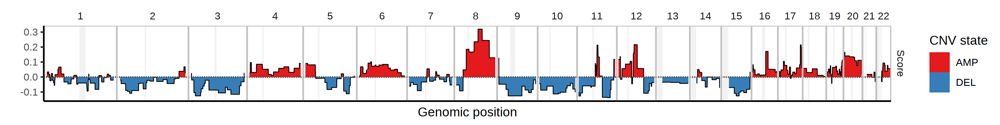

In [486]:
options(repr.plot.width = 12, repr.plot.height = 1.5, repr.plot.res = 300)

segs_exclude = gaps_hg38 %>% filter(end - start > 1e+06) %>% 
    rename(seg_start = start, seg_end = end) %>%
    rbind(acen) %>%
    mutate(CHROM = as.integer(CHROM))

p_copykat = copykat.cna %>%
    mutate(cn = ifelse(score_avg > 0, 'AMP', 'DEL')) %>%
    filter(CHROM != 23) %>%
    mutate(var = 'Score') %>%
    ggplot(
    ) + 
    geom_rect(
        inherit.aes = F, 
        data = segs_exclude, 
        aes(xmin = seg_start, xmax = seg_end, ymin = -Inf, ymax = Inf), 
        fill = "gray95"
    ) +
    geom_rect(
        aes(xmin = seg_start, xmax = seg_end, ymin = 0, ymax = score_avg, fill = cn),
        alpha = 1, size = 0
    ) +
    geom_line(
        aes(x = POS, y = score_avg),
        size = 0.25
    ) +
    geom_hline(yintercept = 0, linetype = 'dashed', color = 'gray30') +
    facet_grid(var~CHROM, space = 'free_x', scale = 'free_x') +
    theme_classic() +
    theme(
        panel.spacing.x = unit(0, 'mm'),
        panel.spacing.y = unit(1, 'mm'),
        panel.border = element_rect(size = 0.5, color = 'gray', fill = NA),
        strip.background = element_blank(),
        axis.text.x = element_blank(),
        axis.ticks.x = element_blank()
    ) +
    scale_fill_manual(values = c(pal[1], pal[2])) +
    ylab('Score') +
    guides(fill = guide_legend(title = 'CNV state')) +
    xlab('Genomic position') +
    ylab('')

p_copykat = ggrastr::rasterize(p_copykat, layers = 'Rect', dpi = 300)

p_copykat

In [158]:
bulk_subtrees = fread('~/paper_data/numbat_out/DCIS1/bulk_subtrees_2.tsv.gz') %>% relevel_chrom()

In [316]:
ref_internal = aggregate_counts(count_mat = count_mat[,normal_cells], annot = data.frame(cell = normal_cells, group = 'Normal'))

cell_dict
Normal 
   379 


In [462]:
bulk = get_bulk(
    count_mat[,tumor_cells],
    ref_hca,
    df %>% filter(cell %in% tumor_cells),
    gtf_hg38,
    genetic_map_hg38
) %>%
analyze_bulk(t = 1e-5)

Retesting CNVs..



In [463]:
options(repr.plot.width = 12, repr.plot.height = 2.35, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

p_numbat = bulk %>%
    plot_psbulk(phi_mle = T, legend = F, use_pos = TRUE, exclude_gap = TRUE, min_depth = 20, raster = T)

Warning message:
“attributes are not identical across measure variables; they will be dropped”
Warning message:
“Using alpha for a discrete variable is not advised.”


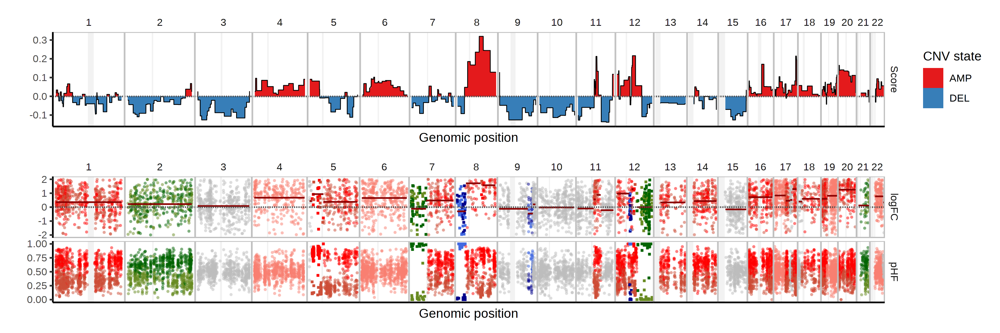

In [487]:
options(repr.plot.width = 12, repr.plot.height = 4, repr.plot.res = 300)

panel = (p_copykat / p_numbat) + plot_layout(heights = c(1.5,2))

do_plot(panel, 'DCIS_cnv', 12, 4)

Warning message:
“attributes are not identical across measure variables; they will be dropped”
Warning message:
“Using alpha for a discrete variable is not advised.”


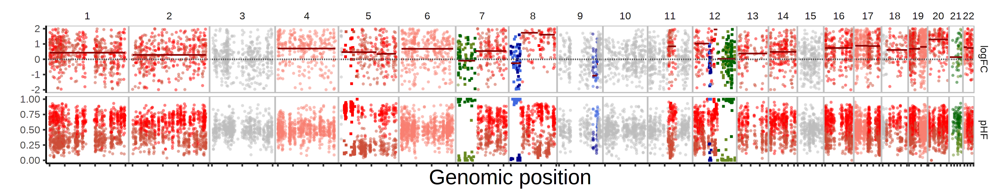

In [177]:
options(repr.plot.width = 12, repr.plot.height = 2.35, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

p = bulk %>%
    annot_consensus(nb[[sample]]$segs_consensus) %>%
    plot_psbulk(phi_mle = T, legend = F, use_pos = TRUE, exclude_gap = FALSE, min_depth = 20, raster = T) +
    theme(axis.title.x = element_text(size = 18))

do_plot(p, 'DCIS1_bulk', 12, 2.35)

# TNBC1

In [74]:
nb = list()

In [143]:
chrs = c(1,2,3)

In [32]:
R.utils::sourceDirectory('~/Numbat/R')

clone_post = get_clone_post(
    nb[[sample]]$gtree, 
    nb[[sample]]$exp_post,
    nb[[sample]]$allele_post
)

gtree = nb[[sample]]$gtree
exp_post = nb[[sample]]$exp_post 
allele_post = nb[[sample]]$allele_post

In [599]:
# sample = 'ATC2_test'
# gtree = nb[[sample]]$gtree

# gtree %>% 
#     ggraph(
#         layout = 'dendrogram',
#         length = length
#     ) +
#     geom_edge_elbow(edge_width = 0.2) +
#     coord_flip() +
#     scale_y_reverse() +
#     scale_x_reverse() +
#     theme_bw()

In [ ]:
sample = 'TNBC1'
nb[[sample]] = Numbat$new(glue('~/paper_data/numbat_out/{sample}'), i = 2)

In [136]:
do_plot = function(p, f, w, h, out_dir = "~/figures", device = "pdf", transparent = FALSE) {
    ggsave(filename = paste0(out_dir, "/", f, ".", device), plot = p, 
        width = w, height = h, device = device, dpi = 300, bg = 'transparent')
    options(repr.plot.width = w, repr.plot.height = h, repr.plot.res = 300)
    print(p)
}

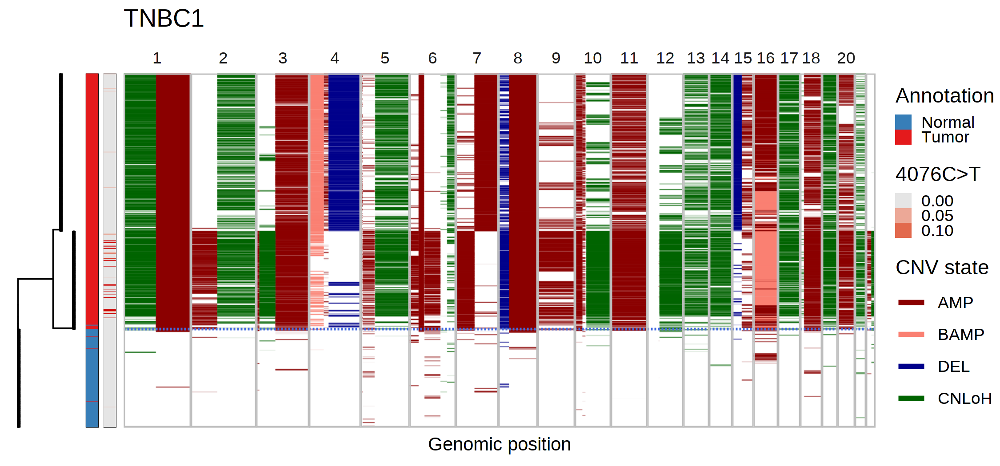

In [41]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC1'
var = '4076C>T'

getPalette = colorRampPalette(pal)

p = plot_phylo_heatmap(
        nb[[sample]]$gtree, 
        nb[[sample]]$joint_post,
        nb[[sample]]$segs_consensus,
        annot = VAF[[sample]] %>% 
            filter(variant == var) %>%
            mutate(VAF = ifelse(DP < 10, NA, VAF)) %>%
            {setNames(.$VAF, .$cell)},
        annot_scale = scale_fill_gradient(low = 'gray90', high = 'red3', limits = c(0, 0.15), na.value = 'gray90', oob = scales::squish),
        clone_dict = cell_annot[[sample]] %>% {setNames(c('T' = 'Tumor', 'N' = 'Normal')[.$cluster.pred], .$cell)},
        pal_annot = c('1' = 'red3'),
        annot_title = var,
        pal_clone = c(pal[2], pal[1]),
        tip_length = 1,
        branch_width = 0.3,
        line_width = 0.15,
        clone_title = 'Annotation',
        tree_height = 1.25,
        clone_bar = TRUE,
        raster = TRUE
    ) +
#     theme(axis.title.x = element_blank()) +
    ggtitle(sample) & 
    theme(plot.background = element_rect(fill = "transparent", color = NA)) 

do_plot(p, glue("{sample}_phylogeny"), w = 7.5, h = 3.5)

In [233]:
 nb[[sample]]$bulk_clones %>% 
    filter(sample %in% c(3,4)) %>% 
    mutate(sample = factor(sample, c(4,3))) %>%
    filter(CHROM %in% c(3, 15, 16, 22))%>%
    rowwise() %>%
    filter(!cnv_state_post %in% unlist(str_split(cnv_states, '\\|'))) %>%
    ungroup() %>%
    count(CHROM, seg, cnv_state_post, cnv_states)

CHROM,seg,cnv_state_post,cnv_states,n
<fct>,<chr>,<chr>,<chr>,<int>
3,3a,neu,amp,339
3,3b,neu,loh,1288
3,3c,bamp,amp,2733
15,15a,loh,del,390
22,22a,neu,amp,701
22,22b,amp,loh,806


In [235]:
nb[[sample]]$bulk_clones %>% dim

[1] 140261     87

In [236]:
nb[[sample]]$bulk_clones %>% 
    annot_consensus(nb[[sample]]$segs_consensus) %>%
    count(cnv_state)

cnv_state,n
<chr>,<int>
amp,83036
bamp,3313
del,5942
loh,44390
neu,3580


In [241]:
nb[[sample]]$bulk_clones %>% 
    filter(sample %in% c(3,4)) %>% 
    mutate(sample = factor(sample, c(4,3))) %>%
    filter(CHROM == 22 & sample == 4) %>%
    distinct(seg, cnv_state, p_amp, p_loh, p_neu)

seg,cnv_state,p_neu,p_loh,p_amp
<chr>,<chr>,<dbl>,<dbl>,<dbl>
22a,neu,7.652131e-01,0.84941086,0.08061621
22b,amp,2.239255e-21,0.05526468,0.94473452


In [245]:
nb[[sample]]$bulk_clones %>% 
    filter(sample %in% c(3,4)) %>% 
    mutate(sample = factor(sample, c(4,3))) %>%
    filter(CHROM == 3 & sample == 4) %>%
    distinct(seg, cnv_state_post, cnv_state, cnv_state_post, p_amp, p_loh, p_neu, p_bamp)

seg,cnv_state,p_neu,p_loh,p_amp,p_bamp,cnv_state_post
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
3a,neu,8.817366e-01,1.624688e-01,0.07515144,0.6897407,neu
3b,neu,4.488925e-01,4.562254e-01,0.40069656,0.1430777,neu
3c,bamp,2.890022e-09,2.224385e-11,0.03705775,0.9629422,bamp


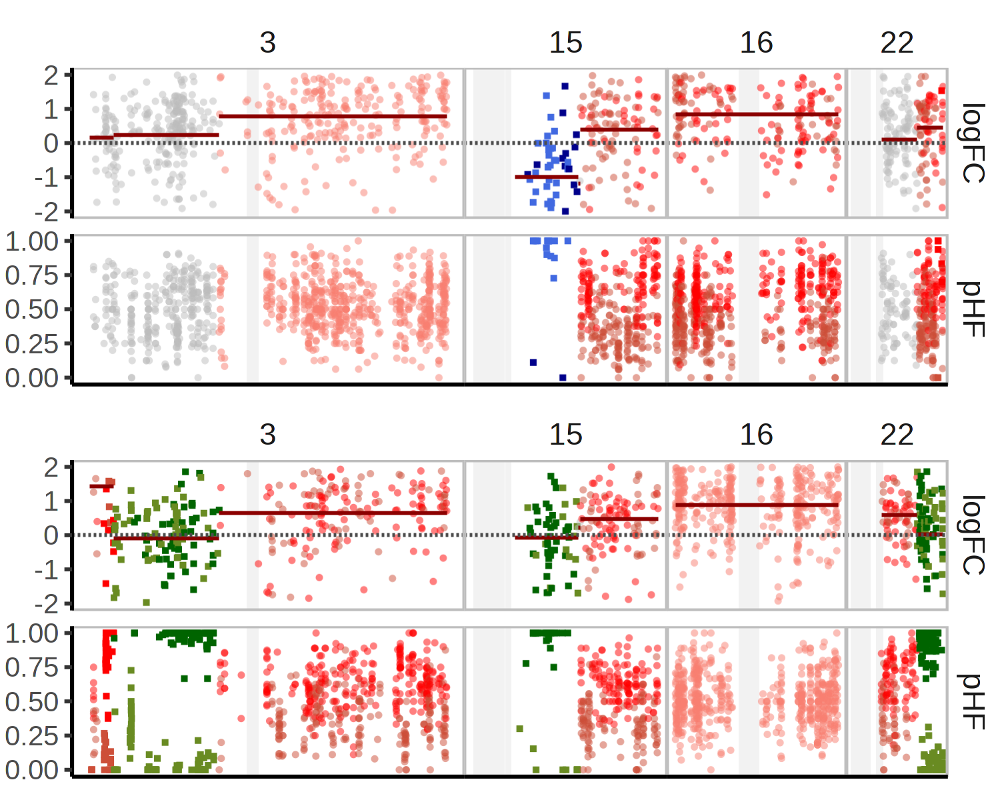

In [460]:
options(repr.plot.width = 5, repr.plot.height = 4, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')
sample = 'TNBC1'

p = nb[[sample]]$bulk_clones %>% 
    filter(sample %in% c(3,4)) %>% 
    mutate(sample = factor(sample, c(4,3))) %>%
    filter(CHROM %in% c(3, 15, 16, 22)) %>%
    plot_bulks(phi_mle = TRUE, legend = F, use_pos = T, title = F, raster = TRUE, exclude_gap = T) & 
    theme(
        strip.text = element_text(size = 11),
        axis.text.y = element_text(size = 10),
        panel.spacing.y = unit(2, 'mm'),
        plot.margin = margin(1, 0, 1, 0, unit = 'mm')
    )

do_plot(p, 'TNBC1_segs', 5, 4)

In [202]:
nb[['TNBC1']]$segs_consensus %>% filter(CHROM == 15)

sample,CHROM,seg,cnv_state,cnv_state_post,seg_start,seg_end,seg_start_index,seg_end_index,theta_mle,⋯,LLR_y,LLR_x,n_genes,n_snps,component,LLR_sample,seg_length,seg_cons,cnv_states,n_states
<int>,<fct>,<chr>,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,⋯,<dbl>,<dbl>,<int>,<int>,<int>,<dbl>,<int>,<chr>,<chr>,<int>
2,15,15a,del,del,22786225,57550343,44272,44755,0.3919180,⋯,451.2808,12.818722,123,375,24,464.0995,34764118,15a,del,1
NA,15,,neu,neu,57591904,58700726,NA,NA,NA,⋯,NA,NA,NA,NA,NA,NA,1108822,15b,neu,0
4,15,15c,amp,amp,58817580,101659107,44764,46431,0.1705887,⋯,237.9312,9.079287,178,1390,39,247.0105,42841527,15c,amp,1


Joining, by = "cell"
Warning message:
“Removed 4 rows containing missing values (geom_point).”
Warning message:
“Removed 5 rows containing missing values (geom_point).”


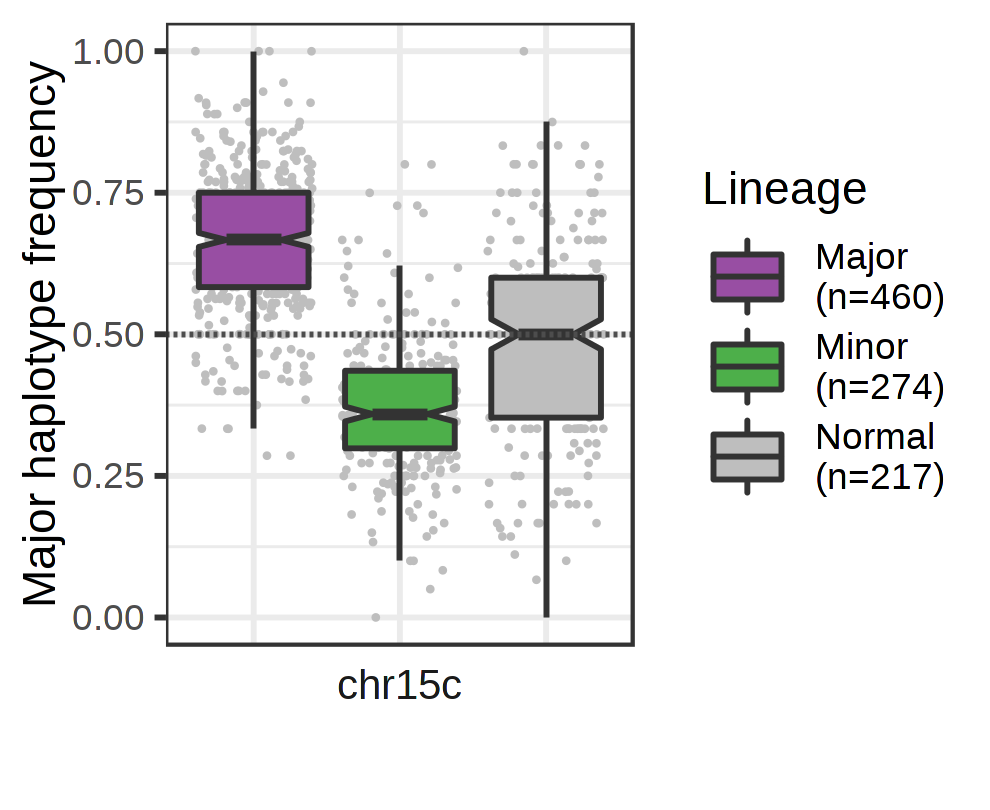

In [101]:
options(repr.plot.width = 3.3, repr.plot.height = 2.7, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC1'
segs = c('15c')
clone_dict = c('4' = 'Major', '3' = 'Minor', '1' = 'Normal')

p = nb[[sample]]$allele_post %>% 
    filter(seg %in% segs) %>%
    mutate(seg = factor(seg, segs)) %>%
    arrange(seg) %>%
    rowwise() %>%
    mutate(seg = paste0('chr', seg)) %>%
    ungroup() %>%
    mutate(seg = factor(seg, unique(seg))) %>%
    left_join(
        nb[[sample]]$clone_post %>%
            select(clone = clone_opt, cell = cell)
    ) %>%
    mutate(clone = clone_dict[as.character(clone)]) %>%
    filter(!is.na(clone)) %>%
    filter(total >= 5) %>%
    group_by(clone) %>%
    mutate(n_clone = n()) %>%
    mutate(clone = glue('{clone}\n(n={n_clone})')) %>%
    ungroup() %>%
    ggplot(
        aes(x = clone, y = MAF, fill = clone)
    ) +
    theme_bw() +
    geom_jitter(size = 0.1, color = 'gray') +
    geom_boxplot(alpha = 1, notch = T, outlier.alpha = 0) +
    geom_hline(yintercept = 0.5, linetype = 'dashed', color = 'gray30') +
    # geom_hline(yintercept = 0.66, linetype = 'dashed', color = 'royalblue') +
    # geom_hline(yintercept = 0.33, linetype = 'dashed', color = 'royalblue') +
    # ggtitle('chr9') +
    facet_wrap(~seg, strip.position = 'bottom') +
    theme(
    #     strip.background = element_rect(size = 0, fill = NULL)
        strip.background = element_blank(),
        panel.spacing = unit(0.5, 'cm'),
        strip.text = element_text(size = 10),
        axis.ticks.x = element_blank(),
        axis.text.x = element_blank(),
        plot.caption = element_text(hjust = 0)
    ) +
    scale_fill_manual(
        values = c(pal[4], pal[3], 'gray'),
        name = 'Lineage'
    ) +
    guides(fill=guide_legend(
             keywidth=0.3,
             keyheight=0.3,
             default.unit="inch")
    ) +
    ylim(0,1) +
    ylab('Major haplotype frequency') +
    xlab('')

do_plot(p, 'TNBC1_chr15', 3.3, 2.7)

In [512]:
segs_consensus = get_segs_consensus(bulk_subtrees)

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



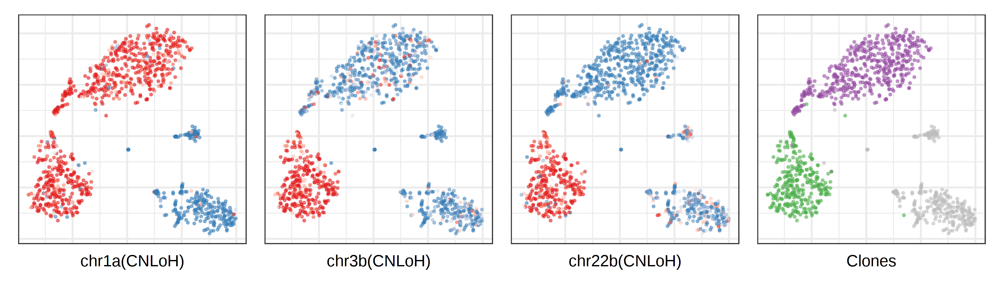

In [92]:
options(repr.plot.width = 10.5, repr.plot.height = 3, repr.plot.res = 300)
sample = 'TNBC1'

muts = c('1a', '3b', '22b')
# cnv_states = c('22_3' = 'CNLOH', '3_3' = 'CNLOH', '4_3' = 'CNLOH', '15_1' = 'del', '1_1' = 'CNLOH')
cnv_states = nb[[sample]]$joint_post %>% distinct(seg, cnv_state) %>% {setNames(.$cnv_state, .$seg)}

p_clones = con_TNBC$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.5, 
    groups = nb[[sample]]$clone_post %>%
#         mutate(clone_opt = ifelse(clone_opt %in% c(5,6), 3, clone_opt)) %>%
        mutate(clone = c('1' = 'Normal', '3' = 'A', '4' = 'B')[as.character(clone_opt)]) %>%
        {setNames(.$clone, .$cell)},
    show.legend = F,
    mark.groups = F,
    plot.na = F,
    plot.theme = theme_bw(),
    raster = T
) +
labs(caption = 'Clones') +
scale_color_manual(values = c('Normal' = 'gray', 'A' = pal[3], 'B' = pal[4])) +
theme(plot.caption = element_text(hjust = 0.5, size = 12))

plist = list()

for (cnv in muts) {
    
    plist[[cnv]] = con_TNBC$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.5,
        plot.na = F, 
        colors = nb[[sample]]$joint_post %>%
            filter(seg == cnv) %>%
            mutate(p_cnv = ifelse(seg == '16_1', p_bamp, p_cnv)) %>%
            {setNames(.$p_cnv, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.theme = theme_bw(),
        raster = T
    ) +
    scale_color_gradient2(low = pal[2], mid = 'white', midpoint = 0.5, high = pal[1], limits = c(0,1)) +
    labs(caption = paste0('chr', cnv, '(', c('amp' = 'AMP', 'loh' = 'CNLoH', 'del' = 'DEL')[cnv_states[cnv]], ')')) +
    theme(plot.caption = element_text(hjust = 0.5, size = 12))
}

plist[[length(plist) + 1]] = p_clones

wrap_plots(plist, nrow = 1, legend = 'top') %>% do_plot('TNBC1_tsne', w = 10.5, h = 3, device = 'pdf')

### Probability legend

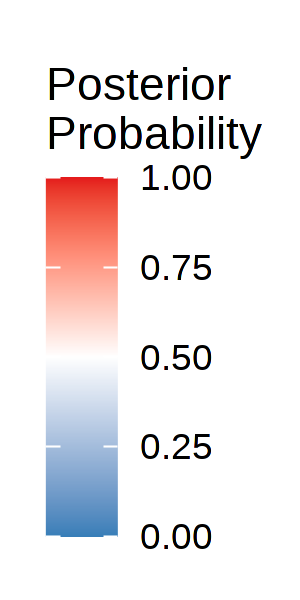

In [32]:
options(repr.plot.width = 1, repr.plot.height = 2, repr.plot.res = 300)

get_legend(
    plist[[cnv]] + theme(legend.position = 'right') +
        guides(color = guide_colorbar(title = 'Posterior\nProbability'))
) %>%
as_ggplot() %>%
do_plot('posterior_legend', 1, 2)

In [703]:
sample = 'TNBC1'

outdir = glue('~/paper_data/numbat_out/{sample}')
gexp.norm.long = fread(glue('{outdir}/gexp.norm.long.tsv.gz'))
hc = readRDS(glue('{outdir}/hc.rds'))

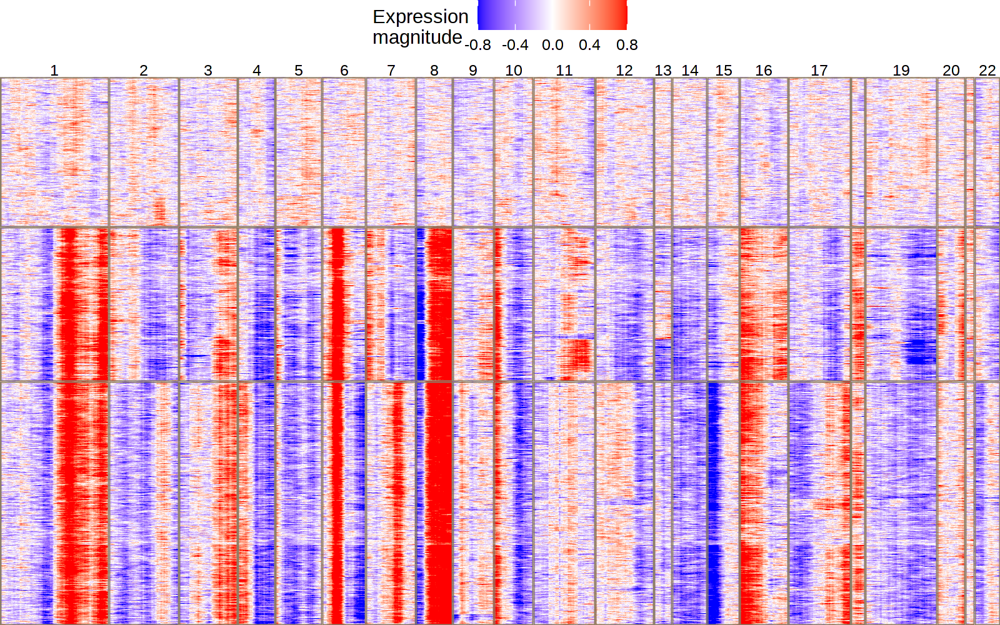

In [713]:
options(repr.plot.width = 8, repr.plot.height = 5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_roll(
    gexp.norm.long,
    hc,
    k = 3,
    n_sample = 3000,
    plot_tree = FALSE
)

Warning message:
“Removed 65 rows containing missing values (geom_point).”


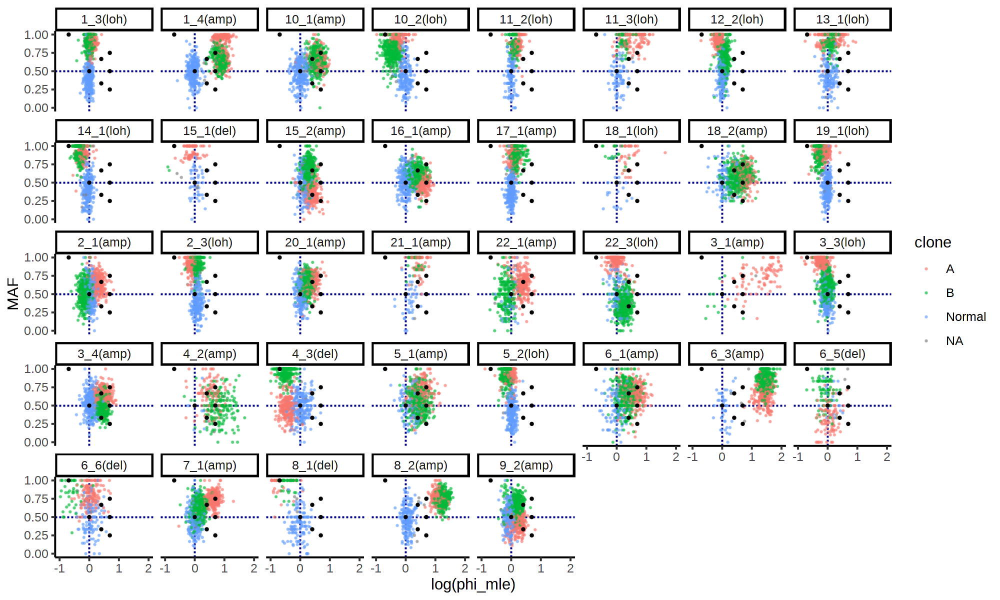

In [1591]:
options(repr.plot.width = 10, repr.plot.height = 6, repr.plot.res = 200)

D = nb[[sample]]$exp_post %>% 
    left_join(
        nb[[sample]]$allele_post %>% select(cell, seg, MAF, total),
        by = c("seg", "cell")
    ) %>%
    left_join(nb[[sample]]$clone_post, by = 'cell') %>%
    mutate(clone = c('1' = 'Normal', '4' = 'A', '5' = 'B')[as.character(clone_opt)]) %>%
    left_join(cell_annot[[sample]], by = 'cell') %>%
    mutate(clone_opt = factor(clone_opt)) 

points = data.frame(
    phi_mle = c(1, 1.5, 1.5, 0.5, 2, 2, 2),
    MAF = c(0.5, 2/3, 1/3, 1, 0.5, 0.25, 0.75)
)

ggplot(
    D %>% filter(total > 5),
    aes(x = log(phi_mle), y = MAF, color = clone)
) +
geom_vline(xintercept = 0, color = 'darkblue', linetype = 'dashed') +
geom_hline(yintercept = 0.5, color = 'darkblue', linetype = 'dashed') +
geom_point(alpha = 0.5, size = 0.2) +
theme_classic() +
facet_wrap(~seg_label, nrow = 5) +
geom_point(
    data = points,
    inherit.aes = F,
    aes(x = log(phi_mle), y = MAF),
    size = 0.5
) +
xlim(-1,2)

# TNBC5

In [80]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC5'
out_dir = glue('~/paper_data/numbat_out/{sample}')
nb[[sample]] = Numbat$new(out_dir, i = 2)

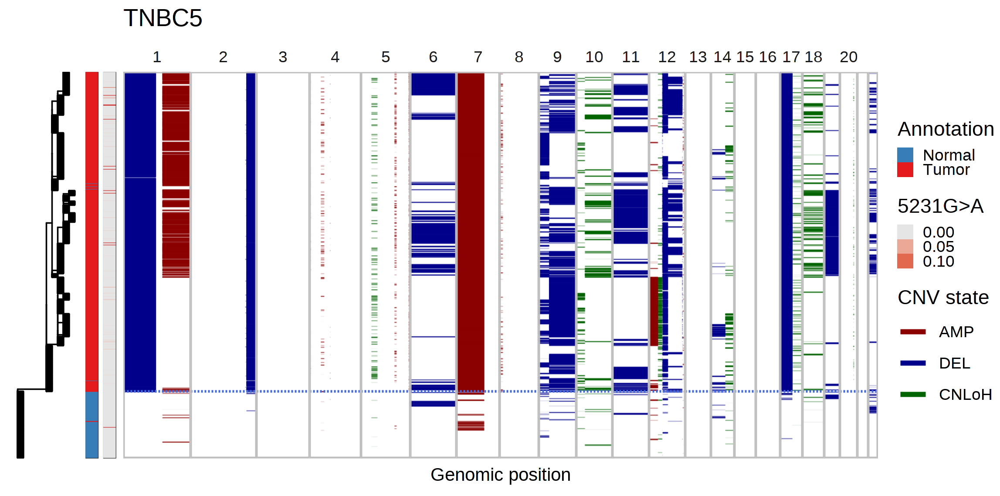

In [491]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'TNBC5'

var = '5231G>A'

p = plot_phylo_heatmap(
    nb[[sample]]$gtree, 
    nb[[sample]]$joint_post,
    nb[[sample]]$segs_consensus,
    annot = VAF[[sample]] %>% 
        filter(variant == var) %>%
#         filter(DP >= 10) %>%
        mutate(VAF = ifelse(DP < 10, NA, VAF)) %>%
        {setNames(.$VAF, .$cell)},
    annot_scale = scale_fill_gradient(low = 'gray90', high = 'red3', limits = c(0, 0.15), na.value = 'gray90', oob = scales::squish),
    clone_dict = cell_annot[[sample]] %>% {setNames(c('T' = 'Tumor', 'N' = 'Normal')[.$cluster.pred], .$cell)},
    pal_annot = c('1' = 'red3'),
    annot_title = var,
    pal_clone = c(pal[2], pal[1]),
    tip_length = 1,
    branch_width = 0.3,
    line_width = 0.15,
    tree_height = 1.25,
    clone_title = 'Annotation',
    clone_bar = TRUE,
    raster = TRUE
) +
ggtitle(sample) &
theme(plot.background = element_rect(fill = "transparent", color = NA))

do_plot(p, glue("{sample}_phylogeny"), w = 7.65, h = 3.8)

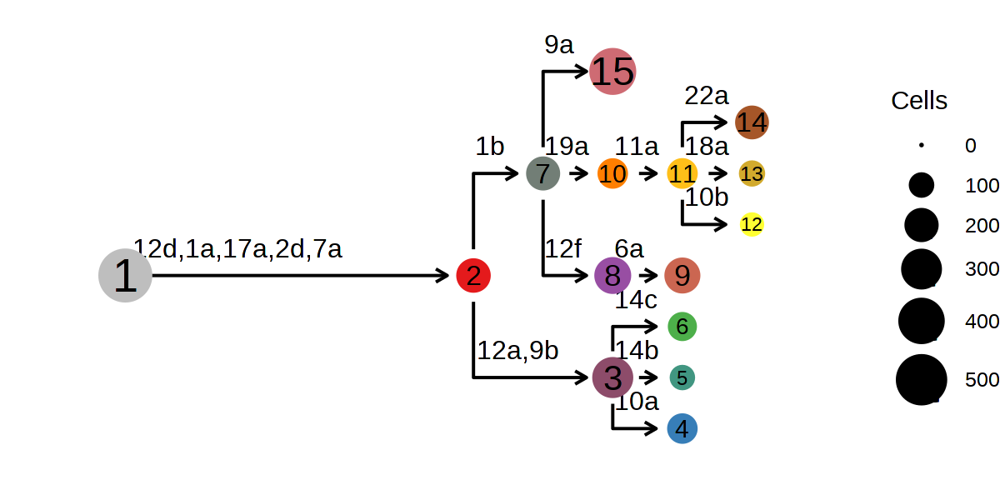

In [489]:
options(repr.plot.width = 6, repr.plot.height = 3, repr.plot.res = 200)

nb[['TNBC5']]$plot_mut_history()

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



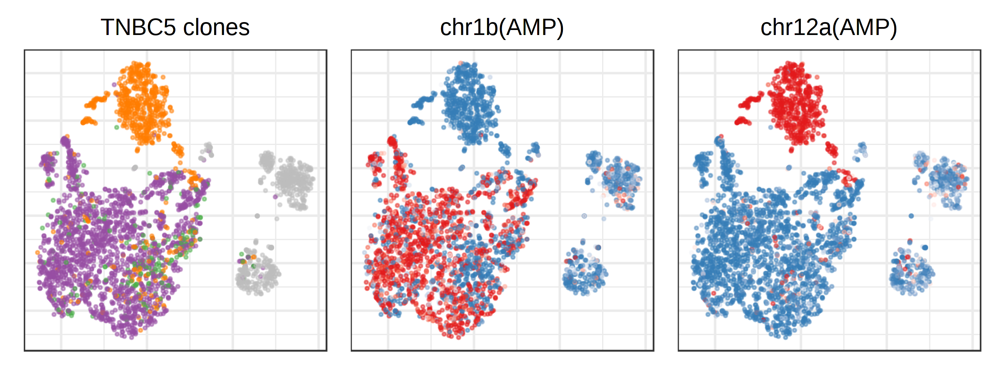

In [488]:
sample = 'TNBC5'
# muts = c('1_7', '12_1')
muts = c('1b', '12a')
# cnv_states = c('22_3' = 'CNLOH', '3_3' = 'CNLOH', '4_3' = 'CNLOH', '15_1' = 'del', '1_1' = 'CNLOH')
cnv_states = nb[[sample]]$joint_post %>% distinct(seg, cnv_state) %>% {setNames(.$cnv_state, .$seg)}
getPalette = colorRampPalette(RColorBrewer::brewer.pal(n = 10, 'Spectral'))

p_clones = con_TNBC$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.5, 
    groups = nb[[sample]]$clone_post %>%
        mutate(clone = case_when(
            clone_opt == 1 ~ 'Normal',
            clone_opt %in% 2 ~ 'Truncal',
            clone_opt %in% 7:15 ~ 'Major',
            clone_opt %in% 3:6 ~ 'Minor'
        )) %>%
        {setNames(.$clone, .$cell)},
    show.legend = F,
    mark.groups = F,
    plot.na = F,
    plot.theme = theme_bw(),
    title = paste0(sample, ' clones'),
#     pal = c('gray', getPalette(length(unique(nb[[sample]]$clone_post$clone_opt))-1)),
    pal = c('Normal' = 'gray', 'Truncal' = pal[3], 'Major' = pal[4], 'Minor' = pal[5]),
    raster = TRUE
) +
theme(plot.title = element_text(hjust = 0.5))

plist = list()
plist[[1]] = p_clones

for (mut in muts) {
    
    plist[[mut]] = con_TNBC$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.5, 
        plot.na = F, 
        colors = nb[[sample]]$joint_post %>%
            left_join(nb[[sample]]$clone_post %>% select(clone_opt, cell), by = 'cell') %>%
            filter(seg == mut) %>%
            {setNames(.$p_cnv - 0.5, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.theme = theme_bw(),
        title = paste0('chr', mut, '(', toupper(cnv_states[mut]), ')'),
        raster = TRUE
#         title = mut
    ) +
    scale_color_gradient2(low = pal[2], mid = 'white', high = pal[1]) +
    theme(plot.title = element_text(hjust = 0.5))
}

panel = wrap_plots(plist, nrow = 1, legend = 'top')

do_plot(panel, 'TNBC5_tsne', 8, 3)

# ATC1

In [80]:
R.utils::sourceDirectory('~/Numbat/R')
sample = 'ATC1'

out_dir = glue('~/paper_data/numbat_out/{sample}')
nb[[sample]] = Numbat$new(out_dir, i = 2)

In [714]:
sample = 'ATC1'

outdir = glue('~/paper_data/numbat_out/{sample}')
gexp.norm.long = fread(glue('{outdir}/gexp.norm.long.tsv.gz'))
hc = readRDS(glue('{outdir}/hc.rds'))

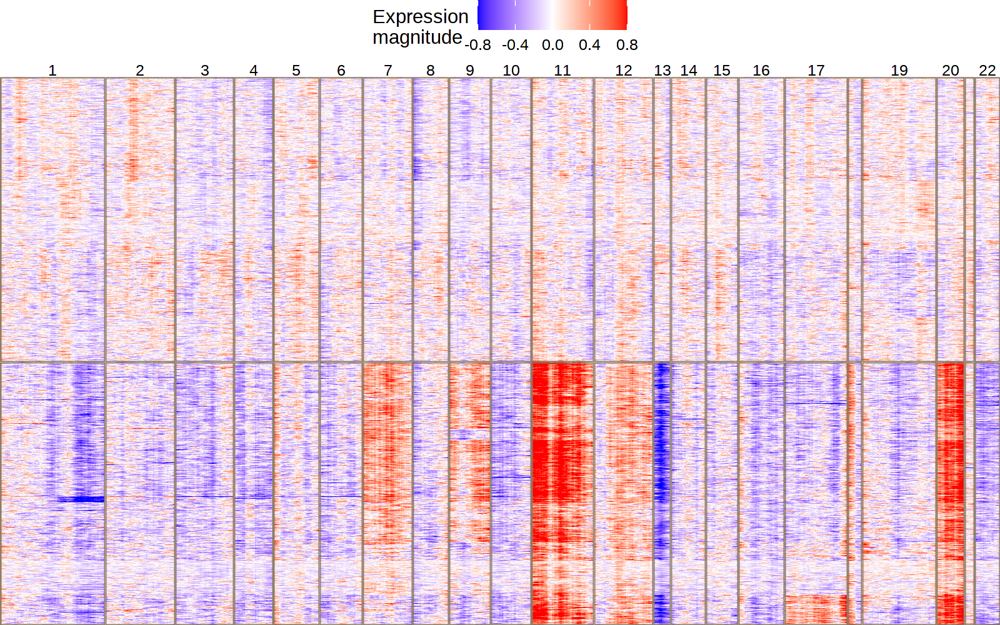

In [717]:
options(repr.plot.width = 8, repr.plot.height = 5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_roll(
    gexp.norm.long,
    hc,
    k = 2,
    n_sample = 1e4,
#     n_sample = 100,
    plot_tree = F
)

Warning message:
“Removed 157 rows containing non-finite values (stat_boxplot).”


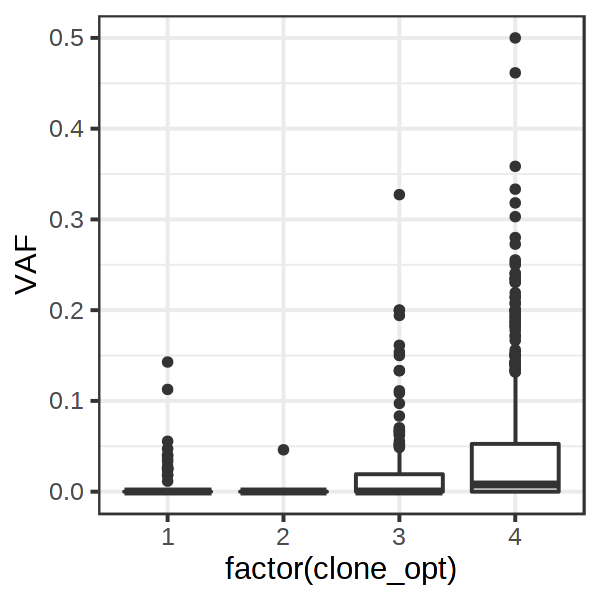

In [2164]:
options(repr.plot.width = 3, repr.plot.height = 3, repr.plot.res = 200)

sample = 'ATC1'

var = '7198G>A'

VAF[[sample]] %>% 
    filter(variant == var) %>%
    left_join(
        nb[[sample]]$clone_post,
        by = 'cell'
    ) %>%
    ggplot(
        aes(x = factor(clone_opt), y = VAF)
    ) +
    geom_boxplot(outlier.size = 1) +
#     geom_violin() +
    theme_bw() +
    coord_cartesian(ylim = c(0, 0.5))

In [81]:
sample = 'ATC1'

In [124]:
de_annot = nb[[sample]]$clone_post %>%
    mutate(cluster = clone_opt) %>%
    filter(cluster %in% c(3,4)) %>%
    mutate(cluster = c('3' = 'major', '4' = 'minor')[as.character(cluster)])

con_ATC$samples[[sample]]$getDifferentialGenes(
    groups = de_annot %>% {setNames(.$cluster, .$cell)},
    append.auc = T
)

Warning message in con_ATC$samples[[sample]]$getDifferentialGenes(groups = de_annot %>% :
“cluster vector doesn't specify groups for all of the cells, dropping missing cells from comparison”


cell_dict
major minor 
  173   867 


Warning message:
“Removed 2 rows containing missing values (geom_point).”
Warning message:
“Removed 2 rows containing missing values (geom_text_repel).”
Warning message:
“ggrepel: 407 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


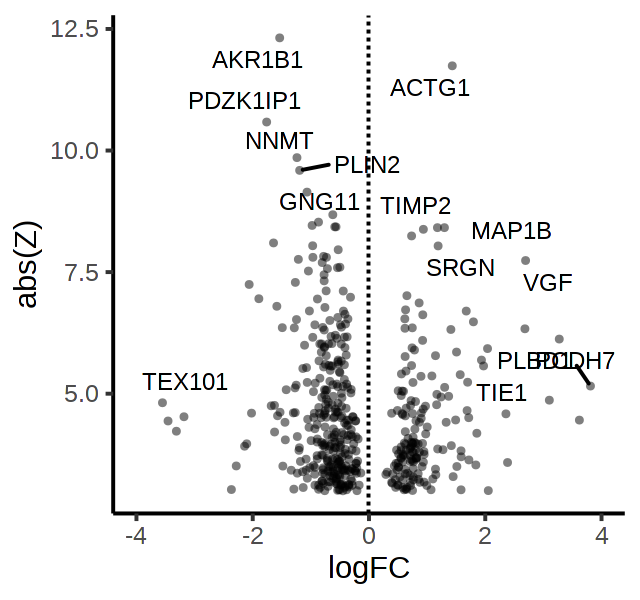

In [140]:
options(repr.plot.width = 3.2, repr.plot.height = 3, repr.plot.res = 200)

fold_changes = aggregate_counts(
        t(con_ATC$samples[[sample]]$misc$rawCounts),
        de_annot %>% mutate(group = factor(cluster))
    ) %>%
    as.matrix %>%
    data.frame() %>%
    setNames(c('lambda_x', 'lambda_y')) %>%
    tibble::rownames_to_column('gene') %>%
    mutate(logFC = log2(lambda_x/lambda_y)) %>%
    filter(!is.na(logFC))

DE = con_ATC$samples[[sample]]$diffgenes$counts$customClustering[[1]] %>%
    tibble::rownames_to_column('gene') %>%
    inner_join(gtf_hg38, by = 'gene') %>%
    left_join(fold_changes, by = 'gene') 

ggplot(
    DE,
    aes(x = logFC, y = abs(Z))
) +
geom_point(size = 1, alpha = 0.5, pch = 16) +
theme_classic() +
scale_color_manual(values = c('gray', 'red')) +
# facet_wrap(~loc) +
ggrepel::geom_text_repel(aes(label = gene), size = 3) +
geom_vline(xintercept = 0, linetype = 'dashed') +
xlim(-4,4)

In [103]:
options(repr.plot.width = 7.5, repr.plot.height = 3.5, repr.plot.res = 300)

p = nb[[sample]]$plot_phylo_heatmap(
            pal_annot = c('1' = 'red3', '0' = 'gray90'),
        annot_scale = scale_fill_gradient(low = NA, high = 'red3', limits = c(0, 0.5), na.value = NA, oob = scales::squish),
        clone_dict = cell_annot[[sample]] %>% {setNames(c('T' = 'Tumor', 'N' = 'Normal')[.$cluster.pred], .$cell)},
        annot_title = 'KRT8',
        pal_clone = c(pal[2], pal[1]),
        annot = con_ATC$samples[[sample]]$counts[,'KRT8'],
        tip_length = 0.5,
        branch_width = 0.3,
        line_width = 0.15,
        clone_title = 'Clones',
        tree_height = 1.25,
        clone_bar = FALSE
    ) +
    ggtitle(sample) & 
    theme(plot.background = element_rect(fill = "transparent", color = NA)) 

do_plot(p, glue("{sample}_phylogeny"), w = 7.5, h = 3.5)

# ggsave(glue("~/figures/{sample}_phylogeny_demo.png"), p, bg = "transparent", width = 7.5, height = 3.5, dpi = 300)

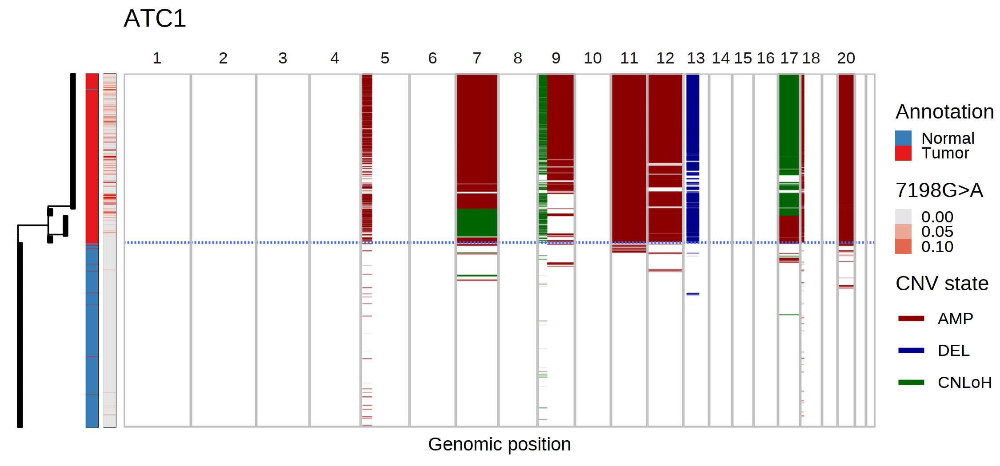

In [42]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC1'
var = '7198G>A'

getPalette = colorRampPalette(pal)

p = plot_phylo_heatmap(
        nb[[sample]]$gtree, 
        nb[[sample]]$joint_post,
        nb[[sample]]$segs_consensus,
        annot = VAF[[sample]] %>% 
            filter(variant == var) %>%
            mutate(VAF = ifelse(DP < 10, NA, VAF)) %>%
            {setNames(.$VAF, .$cell)},
        annot_scale = scale_fill_gradient(low = 'gray90', high = 'red3', limits = c(0, 0.15), na.value = 'gray90', oob = scales::squish),
        clone_dict = cell_annot[[sample]] %>% {setNames(c('T' = 'Tumor', 'N' = 'Normal')[.$cluster.pred], .$cell)},
        pal_annot = c('1' = 'red3'),
        annot_title = var,
        pal_clone = c(pal[2], pal[1]),
        tip_length = 0.5,
        branch_width = 0.3,
        line_width = 0.15,
        clone_title = 'Annotation',
        tree_height = 1.25,
        clone_bar = TRUE,
        raster = TRUE
    ) +
    ggtitle(sample) & 
    theme(plot.background = element_rect(fill = "transparent", color = NA)) 

do_plot(p, glue("{sample}_phylogeny"), w = 7.5, h = 3.5)

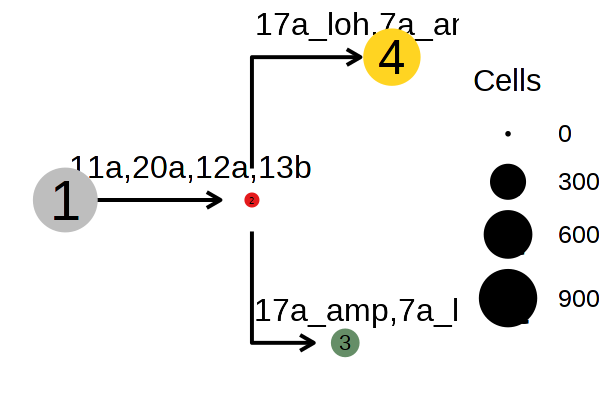

In [655]:
options(repr.plot.width = 3, repr.plot.height = 2, repr.plot.res = 200)

nb[[sample]]$plot_mut_history()

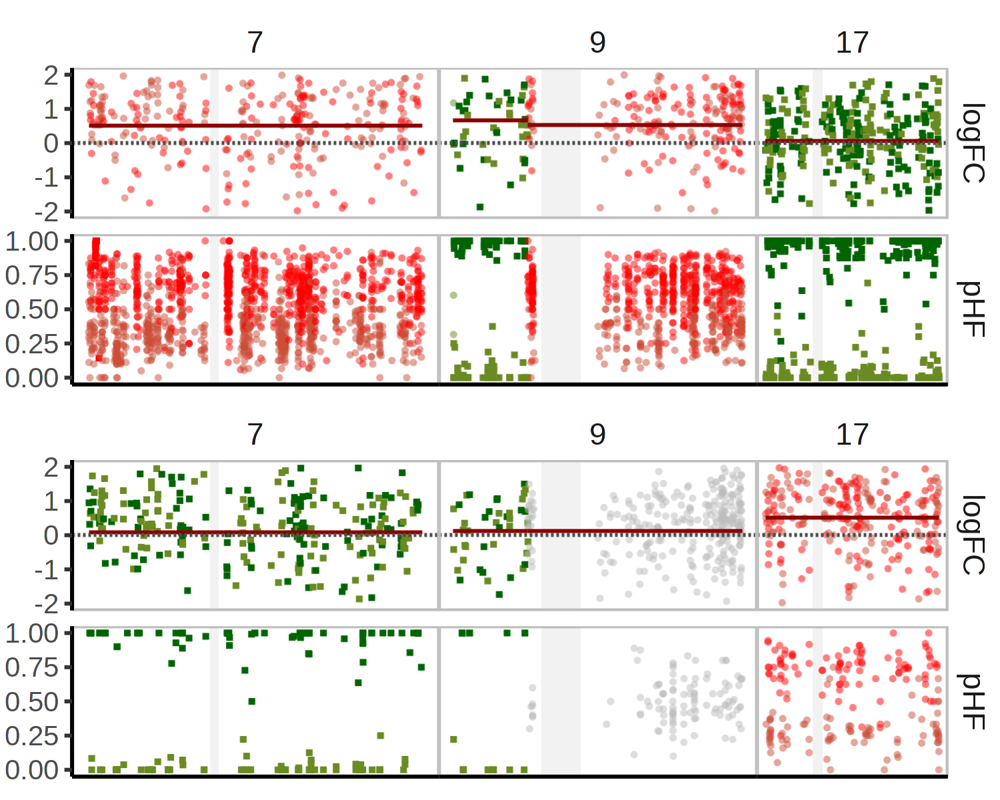

In [461]:
sample = 'ATC1'

p = nb[[sample]]$bulk_clones %>% 
    filter(sample %in% c(3,4)) %>%
    mutate(sample = factor(sample, c(4,3))) %>%
    filter(CHROM %in% c(7, 9, 17)) %>%
    plot_bulks(phi_mle = TRUE, legend = F, title = F, raster = TRUE) &
    theme(
        strip.text = element_text(size = 11),
        axis.text.y = element_text(size = 10),
        panel.spacing.y = unit(2, 'mm'),
        plot.margin = margin(1, 0, 1, 0, unit = 'mm')
    )

do_plot(p, 'ATC1_segs', 5, 4)

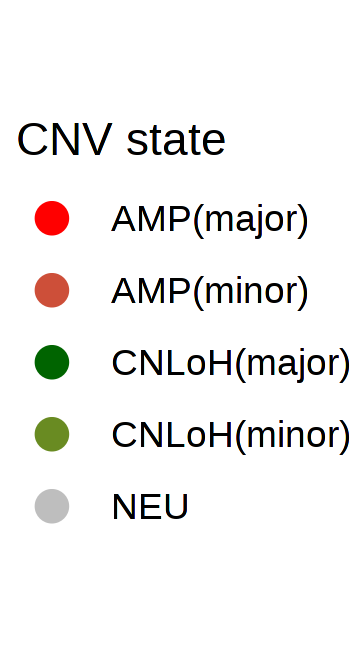

In [88]:
options(repr.plot.width = 1.2, repr.plot.height = 2.2, repr.plot.res = 300)

p = data.frame(
    state = c('AMP_up', 'AMP_down', 'CNLoH_up', 'CNLoH_down', 'NEU')
) %>%
mutate(
    state = state %>% str_replace('_up', '(major)') %>% 
        str_replace('_down', '(minor)')
) %>%
ggplot(
    aes(x = state, y = state, color = state)
) +
geom_point() +
scale_color_manual(
    values = setNames(cnv_colors, names(cnv_colors) %>% 
        str_replace('_up', '(major)') %>% 
        str_replace('_down', '(minor)') %>%
        str_replace('loh', 'CNLoH') %>%
        str_replace('bamp', 'BAMP') %>%
        str_replace('amp', 'AMP') %>%
        str_replace('del', 'DEL') %>%
        str_replace('neu', 'NEU')
    ),
    limits = force
) +
theme_classic() +
guides(color = guide_legend(override.aes = aes(size = 3), title = 'CNV state'))

get_legend(p) %>% as_ggplot %>%
do_plot('ATC1_legend', 1.2, 2.2)

Joining, by = "cell"
Warning message:
“Removed 211 rows containing missing values (geom_point).”


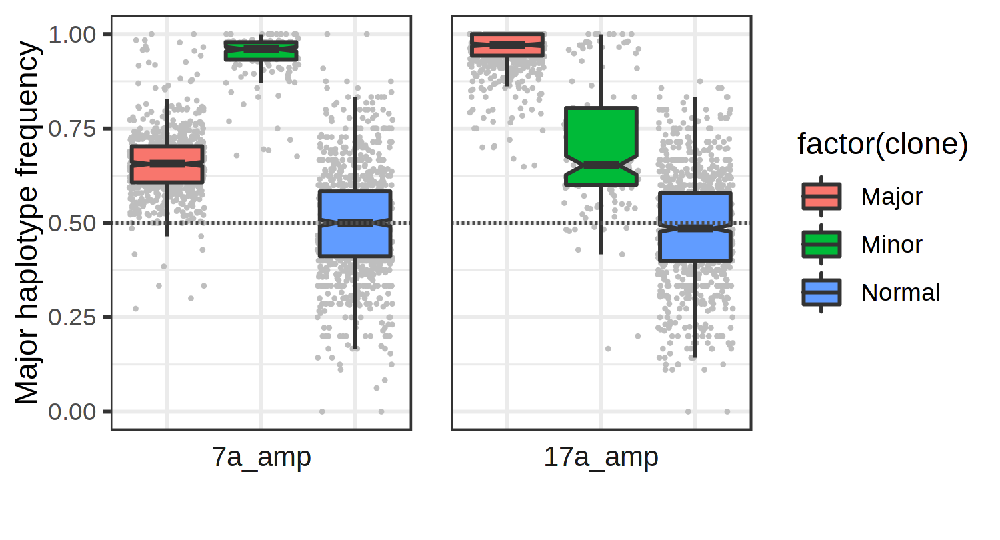

In [644]:
options(repr.plot.width = 5, repr.plot.height = 2.7, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC1'
segs = c('7a_amp', '17a_amp')
clone_dict = c('4' = 'Major', '3' = 'Minor', '1' = 'Normal')

nb[[sample]]$allele_post %>% 
filter(seg %in% segs) %>%
mutate(seg = factor(seg, segs)) %>%
arrange(seg) %>%
mutate(seg = factor(seg, unique(seg))) %>%
left_join(
    nb[[sample]]$clone_post %>%
        select(clone = clone_opt, cell = cell)
) %>%
mutate(clone = clone_dict[as.character(clone)]) %>%
filter(!is.na(clone)) %>%
filter(total >= 5) %>%
ggplot(
    aes(x = clone, y = MAF, fill = factor(clone))
) +
theme_bw() +
geom_jitter(size = 0.1, color = 'gray') +
geom_boxplot(alpha = 1, notch = T, outlier.alpha = 0) +
geom_hline(yintercept = 0.5, linetype = 'dashed', color = 'gray30') +
# geom_hline(yintercept = 0.66, linetype = 'dashed', color = 'royalblue') +
# geom_hline(yintercept = 0.33, linetype = 'dashed', color = 'royalblue') +
# ggtitle('chr9') +
facet_wrap(~seg, strip.position = 'bottom') +
theme(
#     strip.background = element_rect(size = 0, fill = NULL)
    strip.background = element_blank(),
    panel.spacing = unit(0.5, 'cm'),
    strip.text = element_text(size = 10),
    axis.ticks.x = element_blank(),
    axis.text.x = element_blank(),
    plot.caption = element_text(hjust = 0)
) +
# scale_fill_manual(
#     values = c('Normal' = 'gray', 'Minor' = pal[3], 'Major' = pal[4]),
#     name = 'Clone'
# ) +
ylim(0,1) +
ylab('Major haplotype frequency') +
xlab('')

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



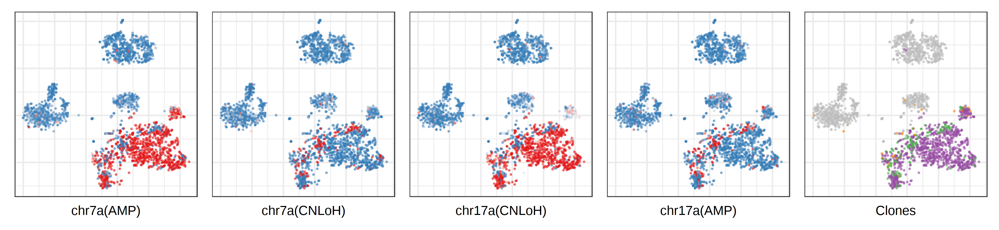

In [91]:
options(repr.plot.width = 13, repr.plot.height = 3, repr.plot.res = 200)
sample = 'ATC1'
con_sample = con_ATC$samples[[sample]]

getPalette = colorRampPalette(RColorBrewer::brewer.pal(n = 5, 'Spectral'))

plot_list = list()

cnvs = c('7a_amp', '7a_loh', '17a_loh', '17a_amp')

for (cnv in cnvs) {

    plot_list[[cnv]] = con_sample$plotEmbedding(
            plot.na = F, 
            alpha = 0.5,
            size = 0.3,
            colors = nb[[sample]]$joint_post %>% 
                filter(seg == cnv) %>%
                {setNames(.$p_cnv, .$cell)},
            mark.groups = F,
            raster = TRUE,
            plot.theme = theme_bw()
        ) +
        scale_color_gradient2(low = pal[2], mid = 'white', high = pal[1], midpoint = 0.5) +
        labs(caption = paste0('chr', str_remove(cnv, '_loh|_amp'), '(', c('amp' = 'AMP', 'loh' = 'CNLoH')[str_extract(cnv, 'amp|loh')], ')')) +
        theme(plot.caption = element_text(hjust = 0.5, size = 12))
}


plot_list[[length(plot_list)+1]] = con_sample$plotEmbedding(
    plot.na = F, 
    alpha = 0.5,
    size = 0.3,
    palette = c('gray', pal[5], pal[3], pal[4]),
    groups = nb[[sample]]$clone_post %>%
        {setNames(.$clone_opt, .$cell)},
    mark.groups = F,
    raster = TRUE
) +
labs(caption = 'Clones') +
theme(plot.caption = element_text(hjust = 0.5, size = 12))
# guides(colour = guide_legend(override.aes = list(size = 2)))

wrap_plots(plot_list, nrow = 1) %>% do_plot('ATC1_tsne', w = 13, h = 3, device = 'pdf')

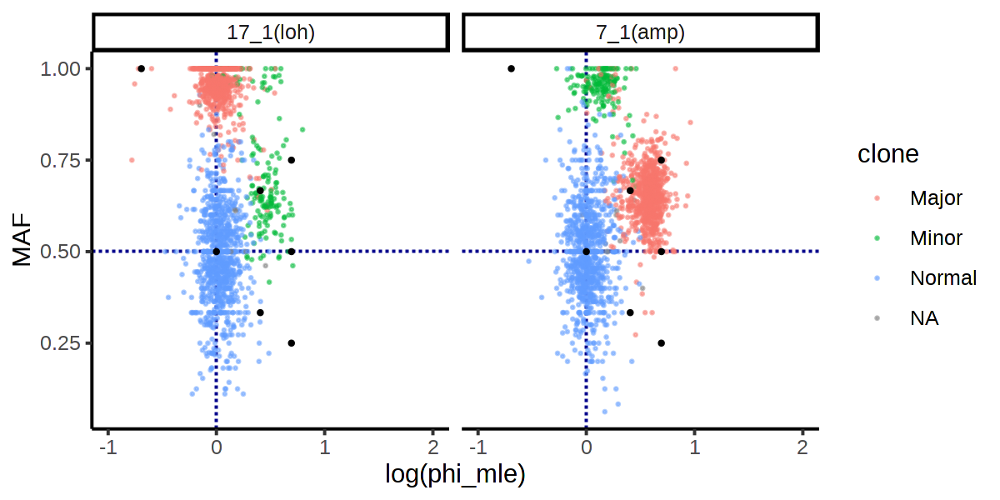

In [674]:
options(repr.plot.width = 6, repr.plot.height = 3, repr.plot.res = 200)

D = nb[[sample]]$exp_post %>% 
    filter(seg %in% segs) %>%
    left_join(
        nb[[sample]]$allele_post %>% select(cell, seg, MAF, total),
        by = c("seg", "cell")
    ) %>%
    left_join(nb[[sample]]$clone_post, by = 'cell') %>%
    mutate(clone = clone_dict[as.character(clone_opt)]) %>%
    left_join(cell_annot[[sample]], by = 'cell') %>%
    mutate(clone_opt = factor(clone_opt)) 

points = data.frame(
    phi_mle = c(1, 1.5, 1.5, 0.5, 2, 2, 2),
    MAF = c(0.5, 2/3, 1/3, 1, 0.5, 0.25, 0.75)
)

ggplot(
    D %>% filter(total >= 8),
    aes(x = log(phi_mle), y = MAF, color = clone)
) +
geom_vline(xintercept = 0, color = 'darkblue', linetype = 'dashed') +
geom_hline(yintercept = 0.5, color = 'darkblue', linetype = 'dashed') +
geom_point(alpha = 0.5, size = 0.2) +
theme_classic() +
facet_wrap(~seg_label, nrow = 1) +
geom_point(
    data = points,
    inherit.aes = F,
    aes(x = log(phi_mle), y = MAF),
    size = 0.5
) +
xlim(-1,2)

# TNBC4

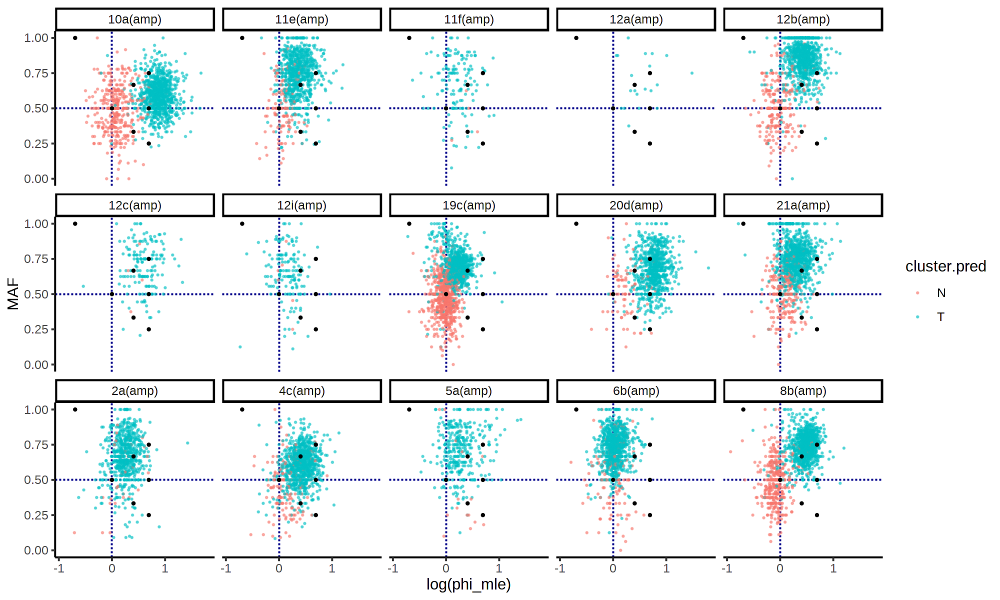

In [1078]:
options(repr.plot.width = 10, repr.plot.height = 6, repr.plot.res = 200)
sample = 'TNBC4'

D = nb[[sample]]$exp_post %>% 
    left_join(
        nb[[sample]]$allele_post %>% select(cell, seg, MAF, total),
        by = c("seg", "cell")
    ) %>%
    left_join(nb[[sample]]$clone_post, by = 'cell') %>%
    left_join(cell_annot[[sample]], by = 'cell') %>%
    mutate(clone_opt = factor(clone_opt)) 

points = data.frame(
    phi_mle = c(1, 1.5, 1.5, 0.5, 2, 2, 2),
    MAF = c(0.5, 2/3, 1/3, 1, 0.5, 0.25, 0.75)
)

ggplot(
    D %>% 
        filter(cnv_state == 'amp') %>%
        filter(total >= 8),
    aes(x = log(phi_mle), y = MAF, color = cluster.pred)
) +
geom_vline(xintercept = 0, color = 'darkblue', linetype = 'dashed') +
geom_hline(yintercept = 0.5, color = 'darkblue', linetype = 'dashed') +
geom_point(alpha = 0.5, size = 0.2) +
theme_classic() +
facet_wrap(~seg_label, nrow = 3) +
geom_point(
    data = points,
    inherit.aes = F,
    aes(x = log(phi_mle), y = MAF),
    size = 0.5
) 

notch went outside hinges. Try setting notch=FALSE.



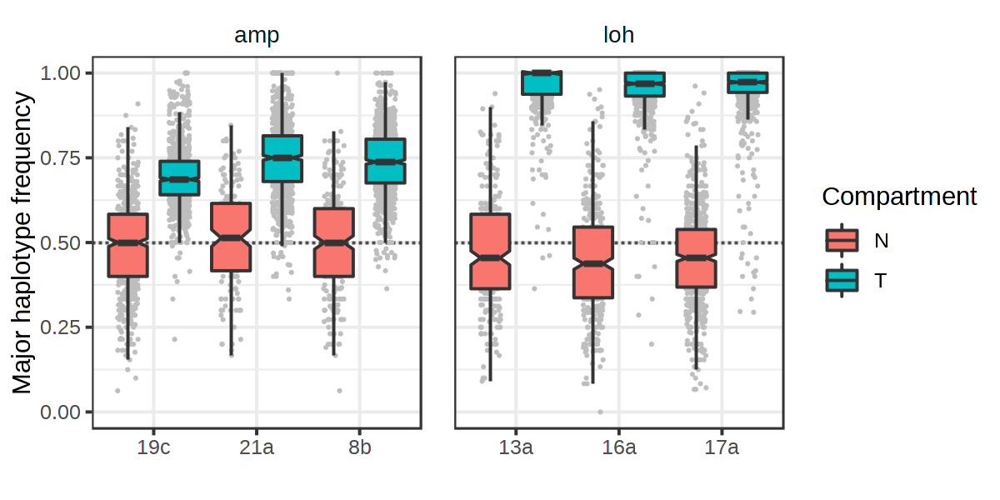

In [1663]:
options(repr.plot.width = 6, repr.plot.height = 3, repr.plot.res = 200)

chroms = c(3, 5, 9, 13:17, 22)

D %>% 
filter((cnv_state == 'amp' & CHROM %in% c(8,19,21)) | (cnv_state == 'loh' & CHROM %in% c(13,16,17))) %>%
filter(total >= 10) %>%
ggplot(
    aes(x = seg, y = MAF, fill = factor(cluster.pred))
) +
theme_bw() +
geom_hline(yintercept = 0.5, linetype = 'dashed', color = 'gray30') +
# geom_hline(yintercept = 0.66, linetype = 'dashed', color = 'red') +
# geom_hline(yintercept = 0.75, linetype = 'dashed', color = 'red') +
# geom_violin(position = position_dodge(width = 1)) +
geom_jitter(size = 0.1, color = 'gray', position = position_jitterdodge(dodge.width = 1)) +
geom_boxplot(alpha = 1, notch = T, outlier.alpha = 0, position = position_dodge(width = 1)) +
theme(
    strip.background = element_blank(),
    panel.spacing = unit(0.5, 'cm'),
    strip.text = element_text(size = 10),
    plot.caption = element_text(hjust = 0)
) +
ylim(0,1) +
ylab('Major haplotype frequency') +
xlab('') +
facet_wrap(~cnv_state, scale = 'free_x') +
guides(fill = guide_legend(title = 'Compartment'))

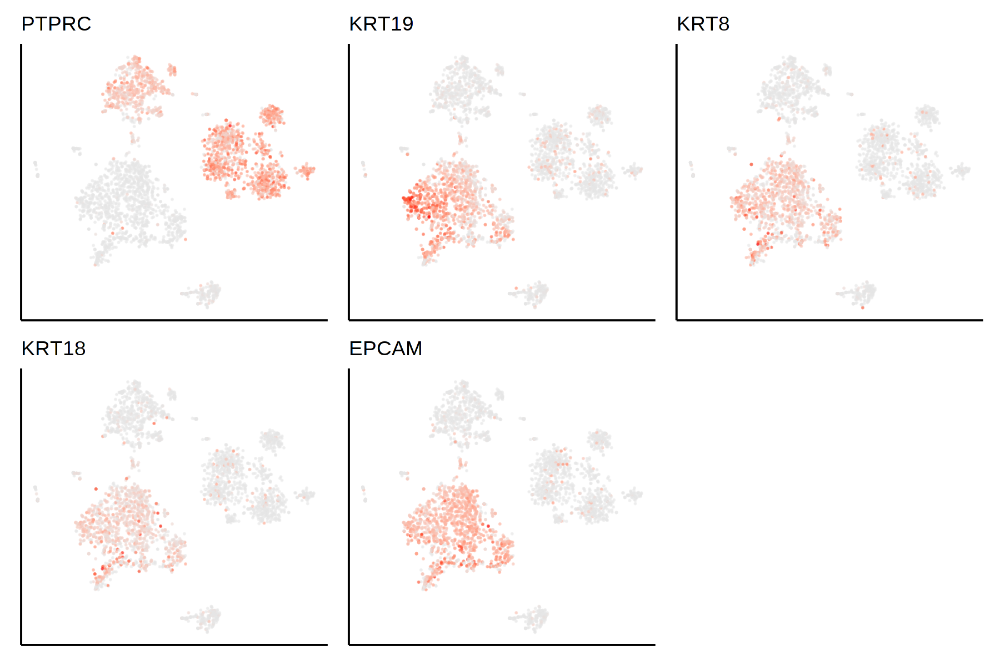

In [1135]:
options(repr.plot.width = 9, repr.plot.height = 6, repr.plot.res = 200)

sample = 'TNBC4'

con_sample = con_TNBC$samples[[sample]]

pal = RColorBrewer::brewer.pal(n = 8, 'Set1')

lapply(
    c('PTPRC', 'KRT19', 'KRT8', 'KRT18', 'EPCAM'),
    function(gene) {
        con_sample$plotEmbedding(
            plot.na = F, 
            size = 0.1,
            alpha = 0.5,
            gene = gene,
            mark.groups = F,
            title = gene,
            plot.theme = theme_classic()
        )
    }
) %>% wrap_plots(nrow = 2)

# ATC2

In [271]:
sample = 'ATC2_subsampled'
out_dir = glue('~/paper_data/numbat_out/{sample}_new')
nb[['ATC2']] = Numbat$new(out_dir, i = 2)

In [516]:
nb[['ATC2_test']] = Numbat$new('~/ATC2_test2', i = 2)

In [499]:
count_mat_ATC2 = readRDS('~/paper_data/processed/ATC2_counts.rds')

In [511]:
cells = cell_annot[['ATC2']] %>% filter(cluster.pred == 'T' | cell %in% colnames(numbat::count_mat_ATC2)) %>% pull(cell)

In [513]:
saveRDS(count_mat_ATC2[,cells], '~/paper_data/processed/ATC2_test_counts.rds')

In [515]:
fread('~/paper_data/processed/ATC2_allele_counts.tsv.gz') %>%
filter(cell %in% cells) %>% 
fwrite('~/paper_data/processed/ATC2_test_allele_counts.tsv.gz')

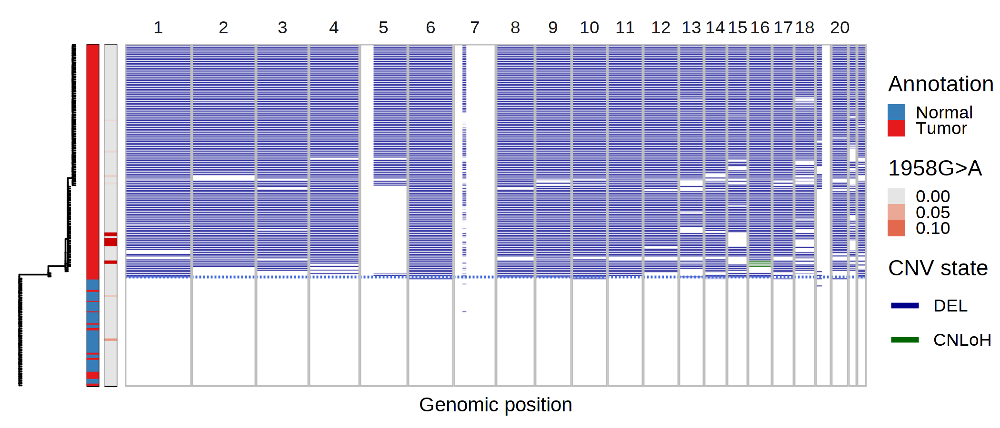

In [520]:
options(repr.plot.width = 7, repr.plot.height = 3, repr.plot.res = 300)

sample = 'ATC2_test'

var = '1958G>A'

plot_phylo_heatmap(
    nb[[sample]]$gtree, 
    nb[[sample]]$joint_post,
    nb[[sample]]$segs_consensus,
    annot = VAF[['ATC2']] %>% 
        mutate(VAF = ifelse(DP < 10, NA, VAF)) %>%
        filter(variant == var) %>%
        {setNames(.$VAF, .$cell)},
    annot_scale = scale_fill_gradient(low = 'gray90', high = 'red3', limits = c(0, 0.15), na.value = 'gray90', oob = scales::squish),
    clone_dict = cell_annot[['ATC2']] %>% {setNames(.$annot, .$cell)},
    annot_title = var,
    pal_clone = c(pal[2], pal[1]),
    tip_length = 1,
    branch_width = 0.3,
    line_width = 0.15,
    tree_height = 1.25,
    clone_title = 'Annotation',
    clone_bar = TRUE,
    raster = TRUE
)

Joining, by = "cell"
Joining, by = "cell"
Joining, by = "cell"


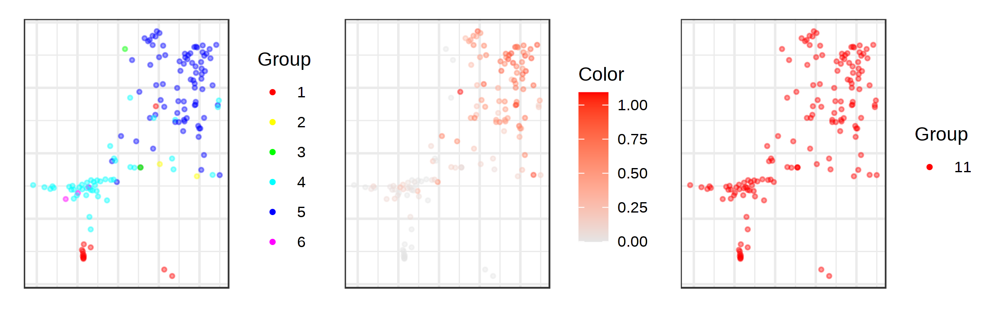

In [573]:
options(repr.plot.width = 8, repr.plot.height = 2.5, repr.plot.res = 300)

sample = 'ATC2'
muts = c('5c', '15a', '19a')
# cnv_states = c('22_3' = 'CNLOH', '3_3' = 'CNLOH', '4_3' = 'CNLOH', '15_1' = 'del', '1_1' = 'CNLOH')
cnv_states = nb[[sample]]$joint_post %>% distinct(seg, cnv_state) %>% {setNames(.$cnv_state, .$seg)}
getPalette = colorRampPalette(RColorBrewer::brewer.pal(n = 4, 'Spectral'))

p1 = con_ATC$samples[[sample]]$plotEmbedding(
    groups = nb[['ATC2_test']]$clone_post %>%
        left_join(cell_annot[['ATC2']]) %>%
        filter(annot == 'Tumor') %>%
        {setNames(.$clone_opt, .$cell)},
    show.legend = T,
    mark.groups = F,
    plot.na = F
)

p2 = con_ATC$samples[[sample]]$plotEmbedding(
    groups = nb[['ATC2_test']]$clone_post %>%
        left_join(cell_annot[['ATC2']]) %>%
        filter(annot == 'Tumor') %>%
        {setNames(.$clone_opt, .$cell)},
    gene = 'KRT8',
    show.legend = T,
    mark.groups = F,
    plot.na = F
)

clusters = con_ATC$samples[[sample]]$clusters$PCA$multilevel

p3 = con_ATC$samples[[sample]]$plotEmbedding(
    groups = nb[['ATC2_test']]$clone_post %>%
        left_join(cell_annot[['ATC2']]) %>%
        filter(annot == 'Tumor') %>%
        mutate(cluster = factor(clusters[cell])) %>%
        {setNames(.$cluster, .$cell)},
    show.legend = T,
    mark.groups = F,
    plot.na = F
)

p1 | p2 | p3

In [539]:
bulk_clones = fread('~/ATC2_test2/bulk_clones_2.tsv.gz')

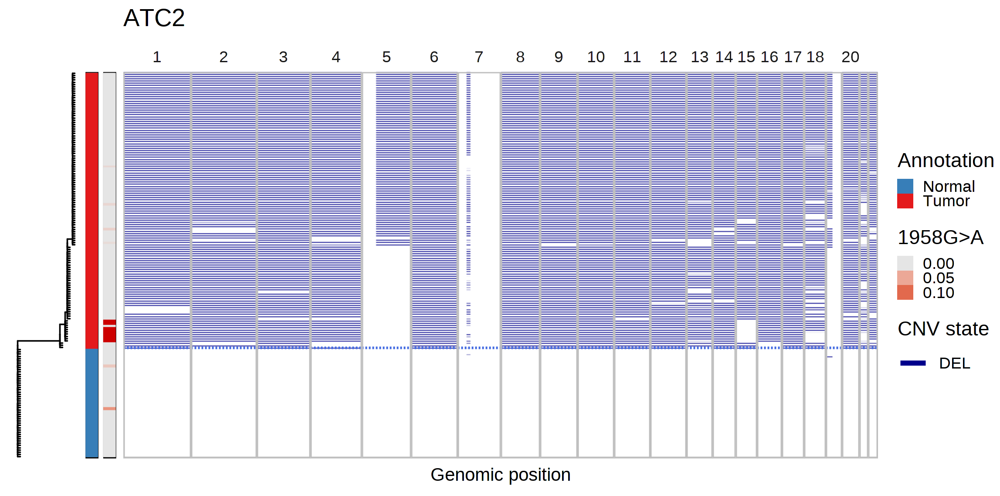

In [39]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC2'

var = '1958G>A'

p = plot_phylo_heatmap(
    nb[[sample]]$gtree, 
    nb[[sample]]$joint_post,
    nb[[sample]]$segs_consensus,
    annot = VAF[[sample]] %>% 
        mutate(VAF = ifelse(DP < 10, NA, VAF)) %>%
        filter(variant == var) %>%
        {setNames(.$VAF, .$cell)},
    annot_scale = scale_fill_gradient(low = 'gray90', high = 'red3', limits = c(0, 0.15), na.value = 'gray90', oob = scales::squish),
    clone_dict = cell_annot[[sample]] %>% {setNames(.$annot, .$cell)},
    annot_title = var,
    pal_clone = c(pal[2], pal[1]),
    tip_length = 1,
    branch_width = 0.3,
    line_width = 0.15,
    tree_height = 1.25,
    clone_title = 'Annotation',
    clone_bar = TRUE,
    raster = TRUE
) +
ggtitle(sample) &
theme(plot.background = element_rect(fill = "transparent", color = NA))

do_plot(p, glue("{sample}_phylogeny"), w = 7.25, h = 3.8)

In [100]:
sample = 'ATC2_subsampled'
out_dir = glue('~/paper_data/numbat_out/{sample}_new')
nb[['ATC2']] = Numbat$new(out_dir, i = 2)

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



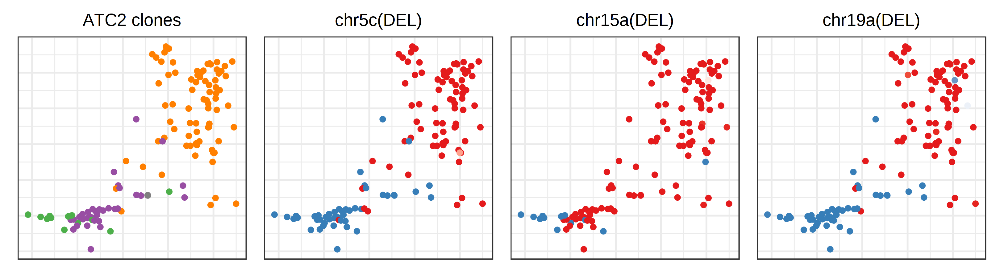

In [33]:
sample = 'ATC2'
muts = c('5c', '15a', '19a')
# cnv_states = c('22_3' = 'CNLOH', '3_3' = 'CNLOH', '4_3' = 'CNLOH', '15_1' = 'del', '1_1' = 'CNLOH')
cnv_states = nb[[sample]]$joint_post %>% distinct(seg, cnv_state) %>% {setNames(.$cnv_state, .$seg)}
getPalette = colorRampPalette(RColorBrewer::brewer.pal(n = 4, 'Spectral'))

p_clones = con_ATC$samples[[sample]]$plotEmbedding(
        alpha=1,
        size=1.5, 
    groups = nb[[sample]]$clone_post %>%
        filter(!clone_opt %in% c(1)) %>%
#         mutate(clone = c('1' = 'Normal', '4' = 'A', '5' = 'B')[as.character(clone_opt)]) %>%
        {setNames(.$clone_opt, .$cell)},
    show.legend = F,
    mark.groups = F,
    plot.na = F,
    plot.theme = theme_bw(),
    title = paste0(sample, ' clones'),
#     pal = c(getPalette(length(unique(nb[[sample]]$clone_post$clone))))
    pal = c(NA, pal[3], pal[4], pal[5]),
    raster = F
) +
theme(plot.title = element_text(hjust = 0.5))
# scale_color_manual(values = c('Normal' = 'gray', 'A' = pal[3], 'B' = pal[4]))

plist = list()
plist[['clones']] = p_clones

for (mut in muts) {
    
    plist[[mut]] = con_ATC$samples[[sample]]$plotEmbedding(
        alpha=1,
        size=1.5, 
        plot.na = F, 
        colors = nb[[sample]]$joint_post %>%
            left_join(nb[[sample]]$clone_post %>% select(clone_opt, cell), by = 'cell') %>%
            filter(!clone_opt %in% c(1)) %>%
            filter(seg == mut) %>%
            {setNames(.$p_cnv - 0.5, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.theme = theme_bw(),
        title = paste0('chr', str_remove(mut, '_'), '(', toupper(cnv_states[mut]), ')'),
        raster = F
#         title = mut
    ) +
    scale_color_gradient2(low = pal[2], mid = 'white', high = pal[1]) +
    theme(plot.title = element_text(hjust = 0.5))

}

panel = wrap_plots(plist, nrow = 1, legend = 'top')

do_plot(panel, 'ATC2_tsne', 10.8, 3)

# ATC3

In [20]:
sample = 'ATC3'
out_dir = glue('~/paper_data/numbat_out/{sample}_new')
nb[[sample]] = Numbat$new(out_dir, i = 1)

In [28]:
R.utils::sourceDirectory('~/Numbat/R')

clone_post = get_clone_post(
    nb[['ATC3']]$gtree, 
    nb[['ATC3']]$exp_post,
    nb[['ATC3']]$allele_post
)

Warning message:
“The `x` argument of `as_tibble.matrix()` must have unique column names if `.name_repair` is omitted as of tibble 2.0.0.
Using compatibility `.name_repair`.
This warning is displayed once every 8 hours.
Call `lifecycle::last_lifecycle_warnings()` to see where this warning was generated.”


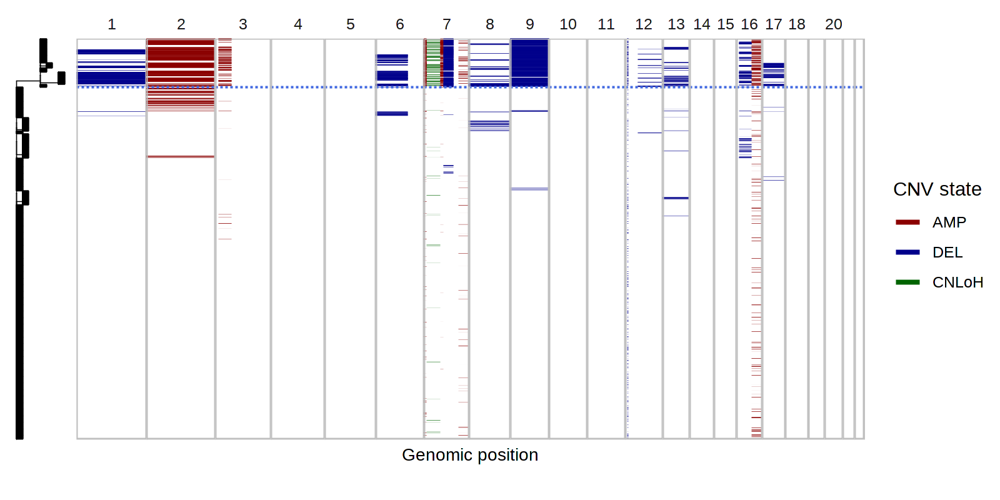

In [21]:
options(repr.plot.width = 8, repr.plot.height = 4, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

nb[['ATC3']]$plot_phylo_heatmap()

# ATC5

In [532]:
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC5'
out_dir = glue('~/paper_data/numbat_out/{sample}')
# out_dir = glue('~/results/MDA/{sample}')
nb[[sample]] = fetch_results(out_dir, i = 2)

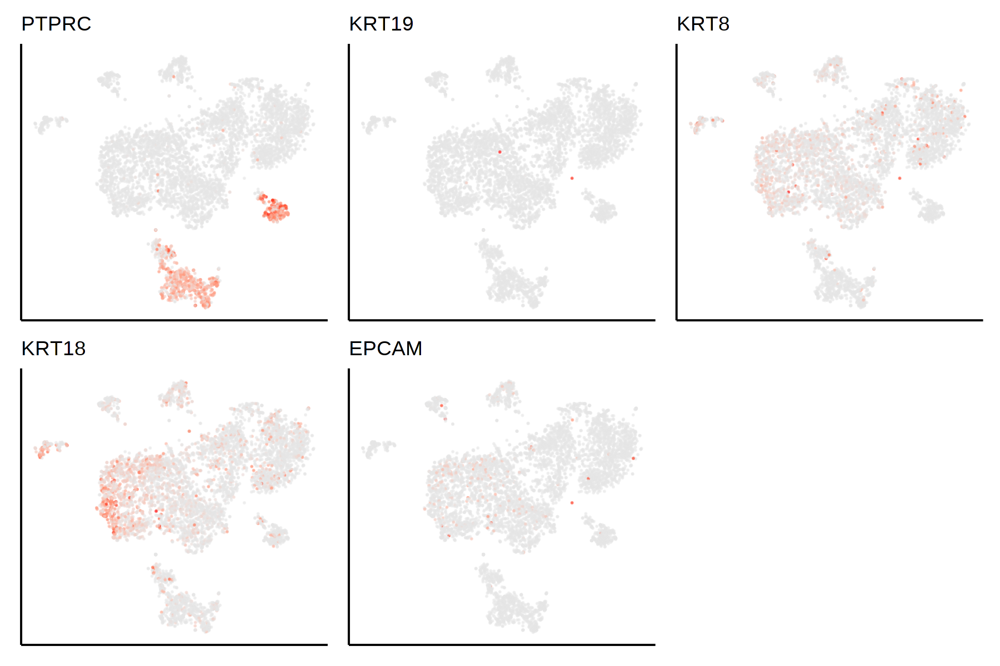

In [542]:
options(repr.plot.width = 9, repr.plot.height = 6, repr.plot.res = 200)

con_sample = con_ATC$samples[[sample]]

pal = RColorBrewer::brewer.pal(n = 8, 'Set1')

lapply(
    c('PTPRC', 'KRT19', 'KRT8', 'KRT18', 'EPCAM'),
    function(gene) {
        con_sample$plotEmbedding(
            plot.na = F, 
            size = 0.1,
            alpha = 0.5,
            gene = gene,
            mark.groups = F,
            title = gene,
            plot.theme = theme_classic()
        )
    }
) %>% wrap_plots(nrow = 2)

In [508]:
chrom_sizes = fread('~/ref/hg38.chrom.sizes.txt') %>% 
    setNames(c('CHROM', 'size')) %>%
    mutate(CHROM = str_remove(CHROM, 'chr')) %>%
    filter(CHROM %in% 1:22) %>%
    mutate(CHROM = factor(CHROM))

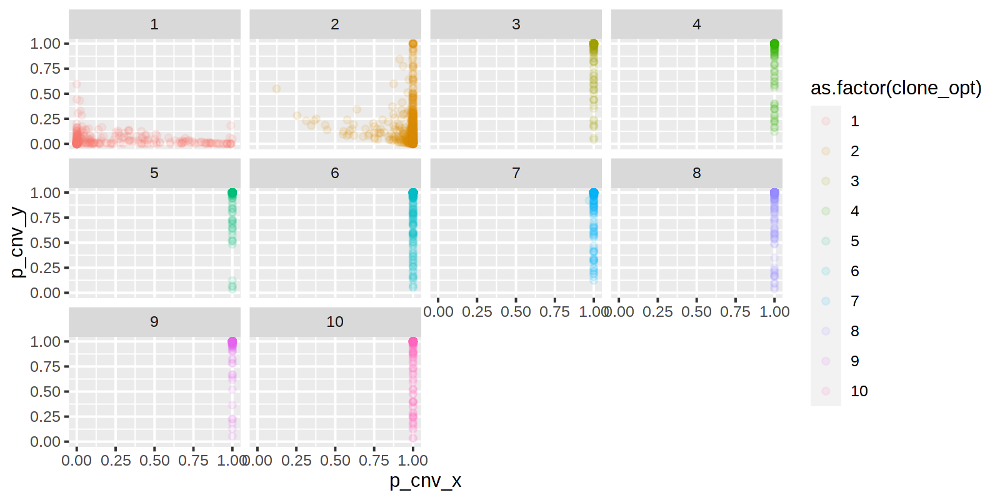

In [539]:
ggplot(
    nb[[sample]]$clone_post,
    aes(x = p_cnv_x, y = p_cnv_y, color = as.factor(clone_opt))
) +
geom_point(alpha = 0.1) +
facet_wrap(~clone_opt)

In [1596]:
# options(repr.plot.width = 8, repr.plot.height = 5, repr.plot.res = 200)
# R.utils::sourceDirectory('~/Numbat/R')

# sample = 'ATC5'

# tree_heatmap(
#     nb[[sample]]$joint_post,
#     nb[[sample]]$gtree,
#     branch_width = 0.3,
#     tip = F,
#     tip_length = 0.1,
#     ratio = 0.8,
#     tvn = F,
#     label_mut = T,
#     cnv_type = F
# ) +
# theme(plot.title = element_text(size = 8))

In [167]:
library(logger)
library(ggraph)

In [182]:
sample = 'ATC5'
tree_post = nb[[sample]]$tree_post
max_cost = 2e5

G_m = get_mut_tree(tree_post$gtree, tree_post$mut_nodes)  %>% 
    simplify_history(tree_post$l_matrix, max_cost = max_cost, verbose = T) %>% 
    label_genotype()

mut_nodes = G_m %>% igraph::as_data_frame('vertices') %>% 
    select(name = node, site = label, clone = clone, GT = GT)

# update tree
gtree = mut_to_tree(tree_post$gtree, mut_nodes)
nb[[sample]]$gtree = mark_tumor_lineage(gtree)

In [298]:
out_dir = '~/paper_data/numbat_out/ATC5'
i = 2
subtrees = readRDS(glue('{out_dir}/subtrees_{i}.rds'))

In [57]:
clone_post = fread(glue('{out_dir}/clone_post_{i}.tsv'))

# Stability

In [106]:
sample = 'NCI-N87'
out_dir = glue('~/paper_data/numbat_out/{sample}_test')
nb[[sample]] = Numbat$new(out_dir, i = 2)

Could not read the input file ~/paper_data/numbat_out/NCI-N87_test/bulk_clones_final.tsv.gz with data.table::fread(). Please check that the file is valid.



In [98]:
chrom_sizes = fread('~/ref/hg38.chrom.sizes.txt') %>% 
    setNames(c('CHROM', 'size')) %>%
    mutate(CHROM = str_remove(CHROM, 'chr')) %>%
    filter(CHROM %in% 1:22) %>%
    mutate(CHROM = factor(CHROM))

hg38_gaps = fread('~/ref/gaps.38.txt') %>%
        setNames(c('CHROM', 'start', 'end')) %>%
        mutate(CHROM = str_remove(CHROM, 'hs')) %>%
        filter(CHROM %in% 1:22) %>%
        mutate(CHROM = as.factor(as.integer(CHROM))) %>%
        arrange(CHROM)

get_clone_profile = function(joint_post, clone_post) {
    joint_post %>%
    inner_join(
        clone_post %>% select(cell, clone = clone_opt),
        by = 'cell'
    ) %>%
    group_by(clone, CHROM, seg, seg_start, seg_end, cnv_state) %>%
    summarise(
        p_cnv = mean(p_cnv),
        size = n(),
        .groups = 'drop'
    ) %>%
    mutate(CHROM = factor(CHROM, 1:22))
}

compare_subclones = function(clone_post_x, joint_post_x, clone_post_y, joint_post_y, ncores = 1) {

    clone_post_x = clone_post_x %>% filter(GT_opt != '')
    clone_post_y = clone_post_y %>% filter(GT_opt != '')
    
    clone_profile_x = get_clone_profile(
        joint_post_x,
        clone_post_x
    )

    clone_profile_y = get_clone_profile(
        joint_post_y,
        clone_post_y
    )
    
    clone_pairs = expand.grid(
        unique(clone_profile_x$clone), 
        unique(clone_profile_y$clone),
        stringsAsFactors = FALSE
    ) %>%
    setNames(c('x', 'y'))

    clone_scores = clone_pairs %>%
        split(1:nrow(.)) %>%
        mclapply(
            mc.cores = ncores,
            function(pair) {

                jac = compare_segs(
                    clone_profile_x %>% filter(p_cnv > 0.5) %>% filter(clone == pair$x),
                    clone_profile_y %>% filter(p_cnv > 0.5) %>% filter(clone == pair$y)
                )

                list(clone.x = pair$x, clone.y = pair$y, jac = jac)
            }
        ) %>%
        bind_rows()

    clone_matching = inner_join(
            clone_post_x %>% select(cell, clone = clone_opt),
            clone_post_y %>% select(cell, clone = clone_opt),
            by = 'cell'
        ) %>%
        count(clone.x, clone.y) %>%
        mutate(frac = n/sum(n)) %>%
        group_by(clone.x) %>%
        mutate(size.x = sum(n)) %>%
        ungroup() %>%
        group_by(clone.y) %>%
        mutate(size.y = sum(n)) %>%
        ungroup() %>%
        rowwise() %>%
        inner_join(
            clone_scores,
            by = c('clone.x', 'clone.y')
        )
    
    jac = sum(clone_matching$jac * clone_matching$frac)
    
    return(jac)
}

get_stability = function(param, values, nb_list, nb_default, ncores = 1) {
        
    lapply(
        names(nb_list[[1]]),
        function(sample) {
            message(sample)
            mclapply(
                values,
                mc.cores = ncores,
                function(value) {
                                        
                    score_subclone = compare_subclones(
                        nb_list[[value]][[sample]]$clone_post,
                        nb_list[[value]][[sample]]$joint_post,
                        nb_default[[sample]]$clone_post,
                        nb_default[[sample]]$joint_post
                    )

                    score_consensus = compare_segs(
                        nb_list[[value]][[sample]]$segs_consensus %>% filter(cnv_state != 'neu'),
                        nb_default[[sample]]$segs_consensus %>% filter(cnv_state != 'neu')
                    ) %>% suppressWarnings()
                    
                    n_clones = length(unique(nb_list[[value]][[sample]]$clone_post$clone_opt))
                    
                    rand = get_rand(
                        nb_list[[value]][[sample]]$clone_post,
                        nb_default[[sample]]$clone_post
                    )
                    
                    data.frame('consensus' = score_consensus, 'subclone' = score_subclone, 'rand' = rand,
                               'sample' = sample, 'value' = value, 'param' = param, 'n_clones' = n_clones)
                }
            ) %>% 
            bind_rows()
        }) %>%
        bind_rows() %>%
        tidyr::pivot_longer(c('consensus', 'subclone', 'rand', 'n_clones'), names_to = 'metric', values_to = 'score') %>%
        mutate(value = factor(value, unique(value)))
}

In [96]:
get_rand = function(clone_post_x, clone_post_y) {
    
    inner_join(
        clone_post_x %>% select(cell, clone = clone_opt),
        clone_post_y %>% select(cell, clone = clone_opt),
        by = 'cell'
    ) %>%
    {fossil::rand.index(.$clone.x, .$clone.y)}
    
}

In [158]:
library(ggraph)

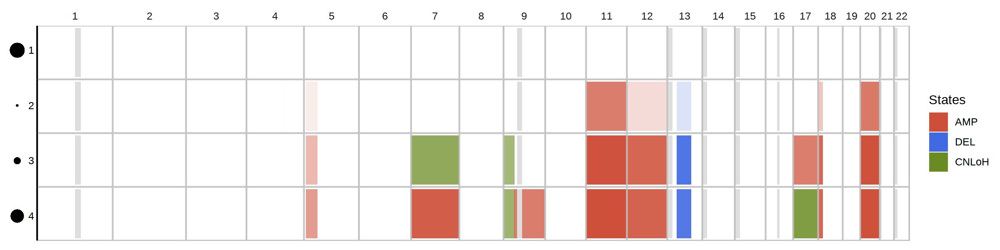

In [30]:
options(repr.plot.width = 12, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

sample = 'ATC1'
i = 3

clone_profile = get_clone_profile(nb_iter[[sample]][[i]]$joint_post, nb_iter[[sample]][[i]]$clone_post)

p_heatmap = clone_profile %>% cnv_heatmap(var = 'clone', label_group = FALSE)

p_bubble = clone_profile %>% 
    ggplot(
        aes(x = 0, y = clone, size = size)
    ) +
    geom_point() +
    guides(size = 'none') +
    theme_void() +
    theme(
        plot.margin = margin(0, 0, 0, 0)
    ) +
    facet_grid(clone~., scale = 'free') +
    scale_size_continuous(
        range = c(0, 5),
        name = 'Cells'
    )

(p_bubble | p_heatmap) + plot_layout(widths = c(0.5,20))

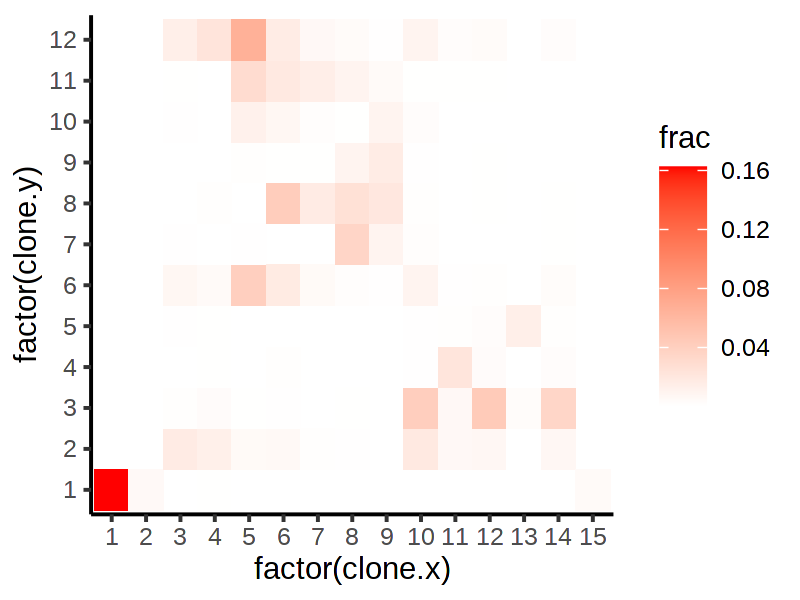

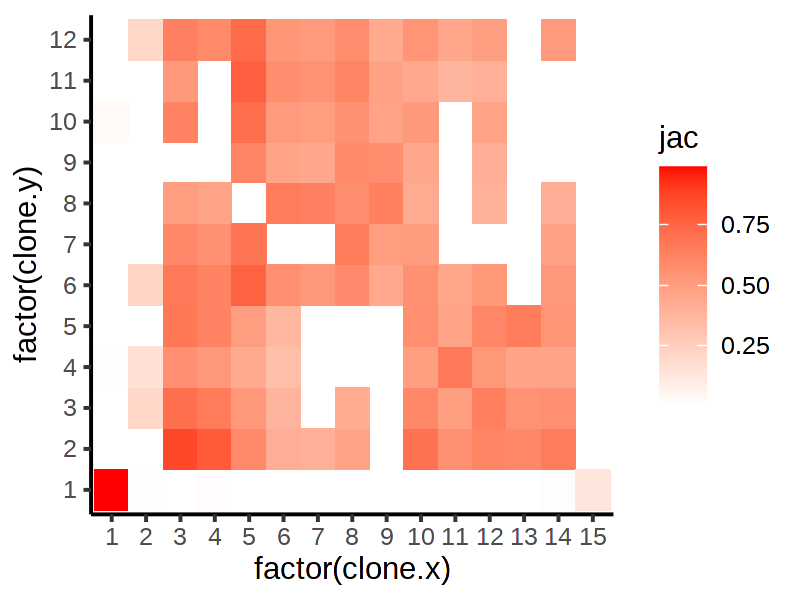

In [2863]:
clone_matching %>% 
ggplot(
    aes(x = factor(clone.x), y = factor(clone.y), fill = frac)
) +
geom_tile() +
theme_classic() +
scale_fill_gradient(low = 'white', high = 'red')

clone_matching %>% 
ggplot(
    aes(x = factor(clone.x), y = factor(clone.y), fill = jac)
) +
geom_tile() +
theme_classic() +
scale_fill_gradient(low = 'white', high = 'red')

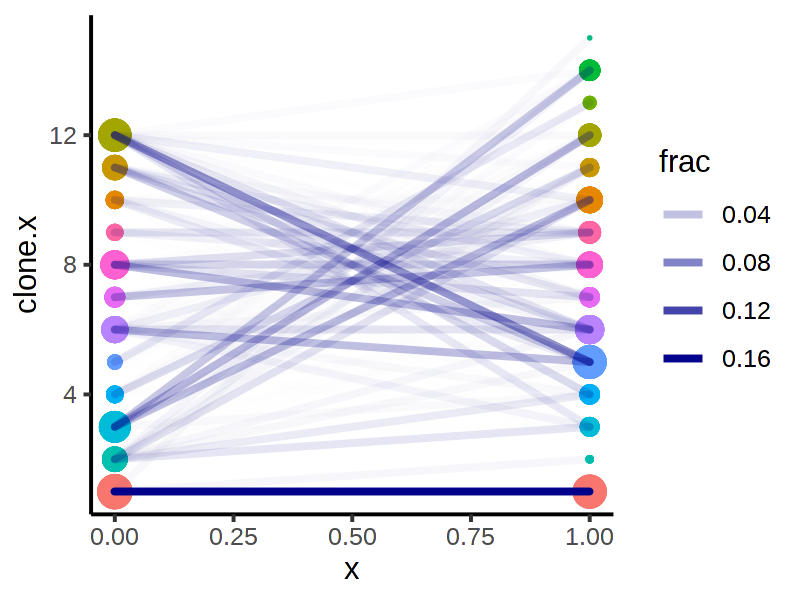

In [2809]:
options(repr.plot.width = 4, repr.plot.height = 3, repr.plot.res = 200)

sample = 'TNBC5'

clone_post_x = nb_iter[[sample]][[1]]$clone_post
clone_post_y = nb_iter[[sample]][[2]]$clone_post

clone_matching %>%
ggplot(
    aes(y = clone.x, x = 0, yend = clone.y, xend = 1, alpha = frac)
) +
geom_point(aes(y = clone.x, x = 0, size = size.x, color = factor(clone.x)), alpha = 1) +
geom_point(aes(y = clone.y, x = 1, size = size.y, color = factor(clone.y)), alpha = 1) +
geom_segment(size = 1, lineend = 'round', color = 'darkblue') +
theme_classic() +
guides(color = 'none', size = 'none') +
scale_alpha_continuous(range = c(0,1)) +
scale_size_continuous(
    range = c(0, 5),
    name = 'Cells'
)

## min_overlap

In [97]:
nb_overlap = list()
overlaps = as.character(c(0.15, 0.3, 0.45, 0.6, 0.75))
samples = c('TNBC1', 'TNBC5', 'ATC2_subsampled', 'ATC1', 'NCI-N87')

for (overlap in overlaps) {
    message(overlap)
    for (sample in samples) {
        out_dir = glue('~/paper_data/numbat_out/{sample}_test_overlap_{overlap}')
        nb_overlap[[overlap]][[sample]] = list()
        nb_overlap[[overlap]][[sample]]$segs_consensus = fread(glue('{out_dir}/segs_consensus_2.tsv'))
        nb_overlap[[overlap]][[sample]]$joint_post = fread(glue('{out_dir}/joint_post_2.tsv'))
        nb_overlap[[overlap]][[sample]]$clone_post = fread(glue('{out_dir}/clone_post_2.tsv'))
    }
}

0.15

0.3

0.45

0.6

0.75



In [99]:
R.utils::sourceDirectory('~/Numbat/R')

overlap_scores = get_stability(
    param = 'overlap',
    values = overlaps, 
    nb_default = nb_overlap[['0.45']], 
    nb_list = nb_overlap, 
    ncores = 5
)

TNBC1

TNBC5

ATC2_subsampled

ATC1

NCI-N87



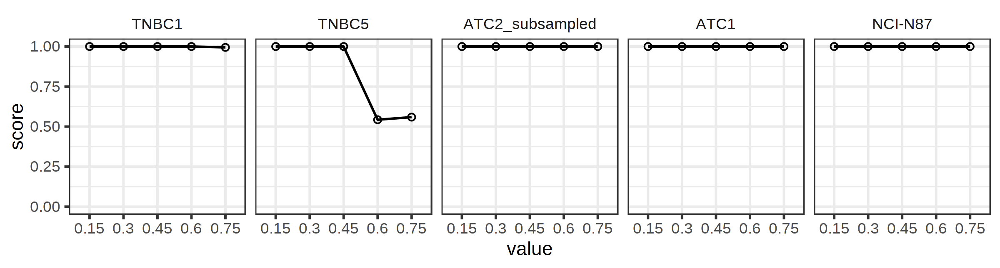

In [816]:
options(repr.plot.width = 8, repr.plot.height = 2.15, repr.plot.res = 300)

samples = c('TNBC1', 'TNBC5', 'ATC2_subsampled', 'ATC1', 'NCI-N87')

overlap_scores %>%
filter(metric == 'adj_rand') %>%
mutate(sample = factor(sample, samples)) %>%
ggplot(
    aes(x = value, y = score, group = metric, shape = metric)
) +
geom_line() +
geom_point() +
theme_bw() +
facet_wrap(~sample, scale = 'free_x', nrow = 1) +
ylim(0,1) +
theme(
    strip.background = element_blank(),
    legend.position = 'none'
) +
scale_shape_manual(values = c(1, 3))

## Iterations

In [100]:
samples = c('ATC1', 'ATC2_subsampled', 'TNBC1', 'TNBC5', 'NCI-N87')

nb_iter = c()
for (i in as.character(1:5)) {
    message(i)
    nb_iter[[i]] = list()
    for (sample in samples) {
        out_dir = glue('~/paper_data/numbat_out/{sample}_test_iter')
        nb_iter[[i]][[sample]] = list()
        nb_iter[[i]][[sample]]$joint_post = fread(glue('{out_dir}/joint_post_{i}.tsv'))
        nb_iter[[i]][[sample]]$segs_consensus = fread(glue('{out_dir}/segs_consensus_{i}.tsv'))
        nb_iter[[i]][[sample]]$clone_post = fread(glue('{out_dir}/clone_post_{i}.tsv'))
    }
}

1

2

3

4

5



In [101]:
R.utils::sourceDirectory('~/Numbat/R')

iter_scores = get_stability(
    param = 'iter',
    values = as.character(1:5), 
    nb_default = nb_iter[['5']], 
    nb_list = nb_iter, 
    ncores = 5
)

ATC1

ATC2_subsampled

TNBC1

TNBC5

NCI-N87



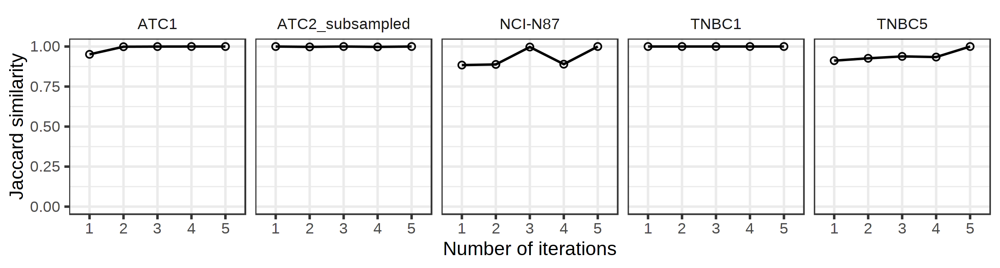

In [803]:
options(repr.plot.width = 8, repr.plot.height = 2.15, repr.plot.res = 300)

iter_scores %>%
filter(metric == 'rand') %>%
ggplot(
    aes(x = value, y = score, group = metric, shape = metric)
) +
geom_line() +
geom_point() +
theme_bw() +
facet_wrap(~sample, scale = 'free_x', nrow = 1) +
ylim(0,1) +
ylab('Jaccard similarity') +
theme(
    strip.background = element_blank(),
    legend.position = 'none'
) +
xlab('Number of iterations') +
scale_shape_manual(values = c(1, 3))

## Random tree

In [102]:
nb_random = list()

for (i in 1:2) {
    nb_random[[i]] = list()
    
    for (seed in 1:5) {
        nb_random[[i]][[seed]] = list()
        message(seed)
        
        for (sample in samples) {
    
            nb_random[[i]][[seed]][[sample]] = list()

            out_dir = glue('~/paper_data/numbat_out/{sample}_test_random_{seed}')

            nb_random[[i]][[seed]][[sample]] = list()
            nb_random[[i]][[seed]][[sample]]$joint_post = fread(glue('{out_dir}/joint_post_{i}.tsv'))
            nb_random[[i]][[seed]][[sample]]$clone_post = fread(glue('{out_dir}/clone_post_{i}.tsv'))
            nb_random[[i]][[seed]][[sample]]$segs_consensus = fread(glue('{out_dir}/segs_consensus_{i}.tsv'))

        }
    }
    
}

1

2

3

4

5

1

2

3

4

5



In [107]:
R.utils::sourceDirectory('~/Numbat/R')

random_scores_1 = get_stability(
    param = 'seed',
    values = 1:5, 
    nb_list = nb_random[[1]], 
    nb_default = nb, 
    ncores = 5
)

random_scores_2 = get_stability(
    param = 'seed',
    values = 1:5, 
    nb_list = nb_random[[2]], 
    nb_default = nb, 
    ncores = 5
)

random_scores = rbind(
    random_scores_1 %>% mutate(iter = '1'),
    random_scores_2 %>% mutate(iter = '2')
)

ATC1

ATC2_subsampled

TNBC1

TNBC5

NCI-N87

ATC1

ATC2_subsampled

TNBC1

TNBC5

NCI-N87



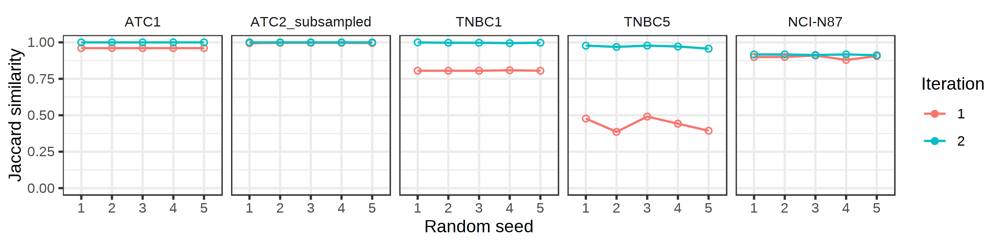

In [511]:
options(repr.plot.width = 8.8, repr.plot.height = 2.15, repr.plot.res = 300)

random_scores %>%
filter(metric == 'consensus') %>%
mutate(sample = factor(sample, samples)) %>%
ggplot(
    aes(x = value, y = score, linetype = metric, color = iter, group = paste0(iter, metric), shape = metric)
) +
geom_line() +
geom_point() +
theme_bw() +
facet_grid(~sample, scale = 'free') +
ylim(0,1) +
ylab('Jaccard similarity') +
theme(
    strip.background = element_blank()
) +
xlab('Random seed') +
scale_shape_manual(values = c(1, 3)) +
guides(shape = 'none', linetype = 'none', color = guide_legend(title = 'Iteration'))

## init_k

In [108]:
ks = as.character(1:5)

nb_k_2 = mclapply(
    mc.cores = 5,
    ks,
    function(k) {
        lapply(
            samples,
            function(sample) {

                out_dir = glue('~/paper_data/numbat_out/{sample}_test_k_{k}')

                list(
                    joint_post = fread(glue('{out_dir}/joint_post_2.tsv')),
                    clone_post = fread(glue('{out_dir}/clone_post_2.tsv')),
                    segs_consensus = fread(glue('{out_dir}/segs_consensus_2.tsv'))
                )

            }
        ) %>% setNames(samples)
    }
)  %>% setNames(ks)

nb_k_1 = mclapply(
    mc.cores = 5,
    ks,
    function(k) {
        lapply(
            samples,
            function(sample) {

                out_dir = glue('~/paper_data/numbat_out/{sample}_test_k_{k}')

                list(
                    joint_post = fread(glue('{out_dir}/joint_post_1.tsv')),
                    clone_post = fread(glue('{out_dir}/clone_post_1.tsv')),
                    segs_consensus = fread(glue('{out_dir}/segs_consensus_1.tsv'))
                )

            }
        ) %>% setNames(samples)
    }
)  %>% setNames(ks)

In [109]:
R.utils::sourceDirectory('~/Numbat/R')

k_scores_1 = get_stability(
    param = 'k',
    values = ks, 
    nb_default = nb_k_1[['3']], 
    nb_list = nb_k_1, 
    ncores = 5
)

k_scores_2 = get_stability(
    param = 'k',
    values = ks, 
    nb_default = nb_k_2[['3']], 
    nb_list = nb_k_2, 
    ncores = 5
)

k_scores = rbind(
    k_scores_1 %>% mutate(iter = '1'),
    k_scores_2 %>% mutate(iter = '2')
) 

ATC1

ATC2_subsampled

TNBC1

TNBC5

NCI-N87

ATC1

ATC2_subsampled

TNBC1

TNBC5

NCI-N87



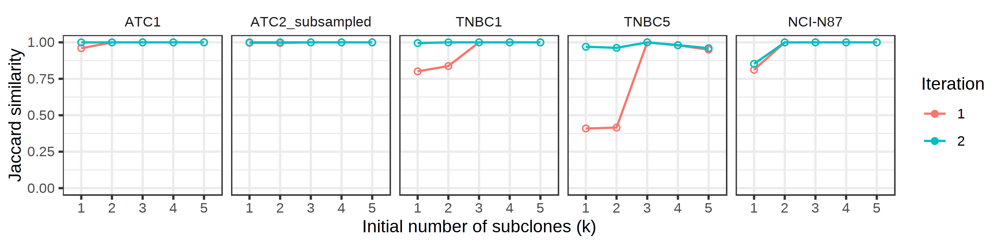

In [576]:
options(repr.plot.width = 8.8, repr.plot.height = 2.15, repr.plot.res = 300)

k_scores %>%
filter(metric == 'consensus') %>%
mutate(sample = factor(sample, samples)) %>%
ggplot(
    aes(x = value, y = score, linetype = metric, color = iter, group = paste0(iter, metric), shape = metric)
) +
geom_line() +
geom_point() +
theme_bw() +
facet_grid(~sample, scale = 'free') +
ylim(0,1) +
ylab('Jaccard similarity') +
theme(
    strip.background = element_blank()
) +
xlab('Initial number of subclones (k)') +
scale_shape_manual(values = c(1, 3)) +
guides(shape = 'none', linetype = 'none', color = guide_legend(title = 'Iteration'))

## Tau

In [110]:
taus = as.character(seq(0.1, 0.5, 0.1))

nb_tau = mclapply(
    mc.cores = 5,
    taus,
    function(cost) {
        lapply(
            samples,
            function(sample) {

                out_dir = glue('~/paper_data/numbat_out/{sample}_test_tau_{cost}')

                list(
                    joint_post = fread(glue('{out_dir}/joint_post_2.tsv')),
                    clone_post = fread(glue('{out_dir}/clone_post_2.tsv')),
                    segs_consensus = fread(glue('{out_dir}/segs_consensus_2.tsv'))
                )

            }
        ) %>% setNames(samples)
    }
)  %>% setNames(taus)

In [111]:
R.utils::sourceDirectory('~/Numbat/R')

tau_scores = get_stability(
    param = 'tau',
    values = taus, 
    nb_default = nb_tau[['0.3']], 
    nb_list = nb_tau, 
    ncores = 5
)

ATC1

ATC2_subsampled

TNBC1

TNBC5

NCI-N87



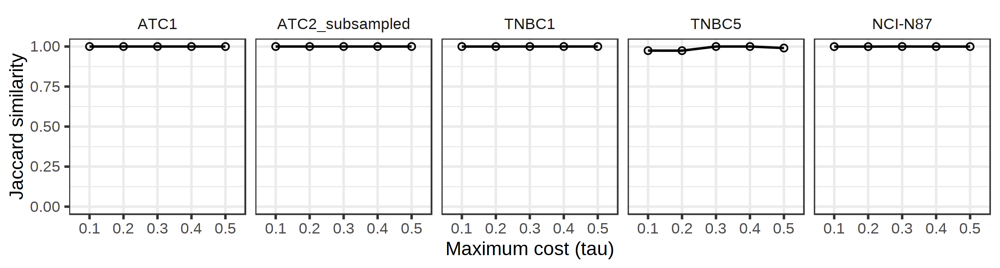

In [516]:
options(repr.plot.width = 8, repr.plot.height = 2.15, repr.plot.res = 300)

tau_scores %>%
filter(metric == 'consensus') %>%
mutate(sample = factor(sample, samples)) %>%
ggplot(
    aes(x = value, y = score, group = metric, shape = metric)
) +
geom_line() +
geom_point() +
theme_bw() +
facet_wrap(~sample, scale = 'free_x', nrow = 1) +
ylim(0,1) +
ylab('Jaccard similarity') +
theme(
    strip.background = element_blank(),
    legend.position = 'none'
) +
xlab('Maximum cost (tau)') +
scale_shape_manual(values = c(1, 3))

## All

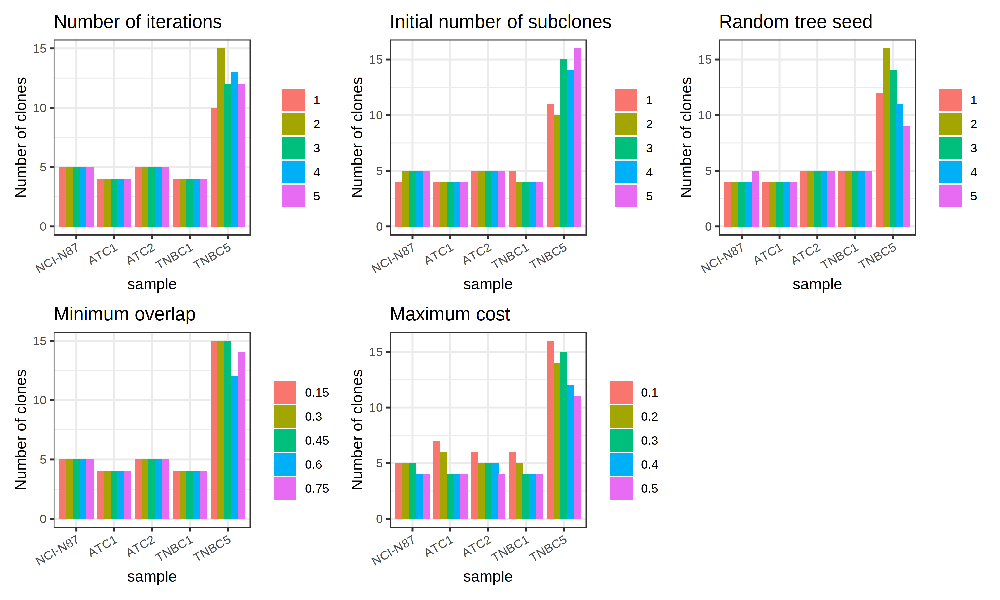

In [193]:
param_titles = c('k' = 'Initial number of subclones', 'tau' = 'Maximum cost', 'overlap' = 'Minimum overlap',
                 'iter' = 'Number of iterations', 'random' = 'Random tree seed')

p = lapply(
    c('iter', 'k', 'random', 'overlap', 'tau'),
    function(param) {
    
        get(glue('{param}_scores')) %>% 
            filter(metric == 'n_clones') %>%
            mutate(value = as.factor(value)) %>%
            mutate(sample = str_remove(sample, '_subsampled')) %>%
            mutate(sample = factor(sample, c('NCI-N87', 'ATC1', 'ATC2', 'TNBC1', 'TNBC5'))) %>%
            ggplot(
                aes(x = sample, y = score, fill = value)
            ) +
            theme_bw() +
            geom_col(position = 'dodge') +
            ylim(0,NA) +
            ylab('Number of clones') +
            theme(
                strip.background = element_blank(),
                axis.text.x = element_text(angle = 30, hjust = 1, vjust = 1)
            ) +
            guides(fill = guide_legend(title = '')) +
            ggtitle(param_titles[param])
    
}) %>%
wrap_plots(nrow = 2)

do_plot(p, 'n_clones_stability', 10, 6)

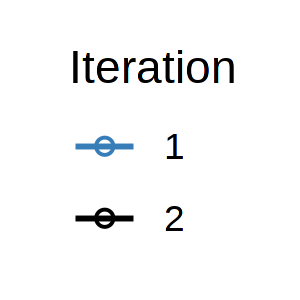

In [198]:
options(repr.plot.width = 1, repr.plot.height = 1, repr.plot.res = 300)

p = k_scores %>% 
    filter(metric == 'subclone') %>%
    mutate(sample = factor(sample, samples)) %>%
    mutate(iter = factor(iter, c('2','1'))) %>%
    ggplot(
        aes(x = value, y = score, group = iter, color = iter)
    ) +
    geom_line(linetype = 'solid') +
    geom_point(pch = 1) +
    theme_bw() +
    scale_color_manual(values = c('1' = pal[2], '2' = 'black')) +
    guides(color = guide_legend(title = 'Iteration'))

ggpubr::get_legend(p) %>% ggpubr::as_ggplot() %>%
do_plot('stability_legend', 1, 1)

In [793]:
# options(repr.plot.width = 8, repr.plot.height = 6, repr.plot.res = 200)

# metric_label = c('consensus' = 'Consensus CNV\nsimilarity', 'subclone' = 'Subclone CNV\nsimilarity', 'n_clones' = 'Number of clones', 'rand' = 'Rand index')

# for (param in c('iter', 'k', 'random', 'overlap', 'tau')) {
    
#     scores = get(glue('{param}_scores'))
        
#     if (!'iter' %in% colnames(scores)) {
#         scores$iter = '2' 
#     }

#     panel = scores %>%
#         arrange(sample) %>%
#         mutate(sample = str_remove(sample, '_subsampled')) %>%
#         mutate(sample = factor(sample, c('NCI-N87', 'ATC1', 'ATC2', 'TNBC1', 'TNBC5'))) %>%
#         mutate(metric = metric_label[metric]) %>%
#         mutate(metric = factor(metric, unname(metric_label))) %>%
#         ggplot(
#             aes(x = value, y = score, group = iter, color = iter)
#         ) +
#         geom_line(linetype = 'solid') +
#         geom_point(pch = 21) +
#         theme_bw() +
#         scale_color_manual(values = c('2' = 'black', '1' = pal[2])) +
#         facet_grid(metric~sample, scale = 'free', switch = 'y') +
#         ylab('') +
#         theme(
#             strip.background = element_blank(),
#             legend.position = 'none',
#             strip.text.y = element_text(angle = 0)
#         ) +
#         xlab(param_titles[param]) +
#         scale_y_continuous(limits = c(0,NA)) +
#         theme(strip.placement = "outside")
    
#     print(panel)
# }

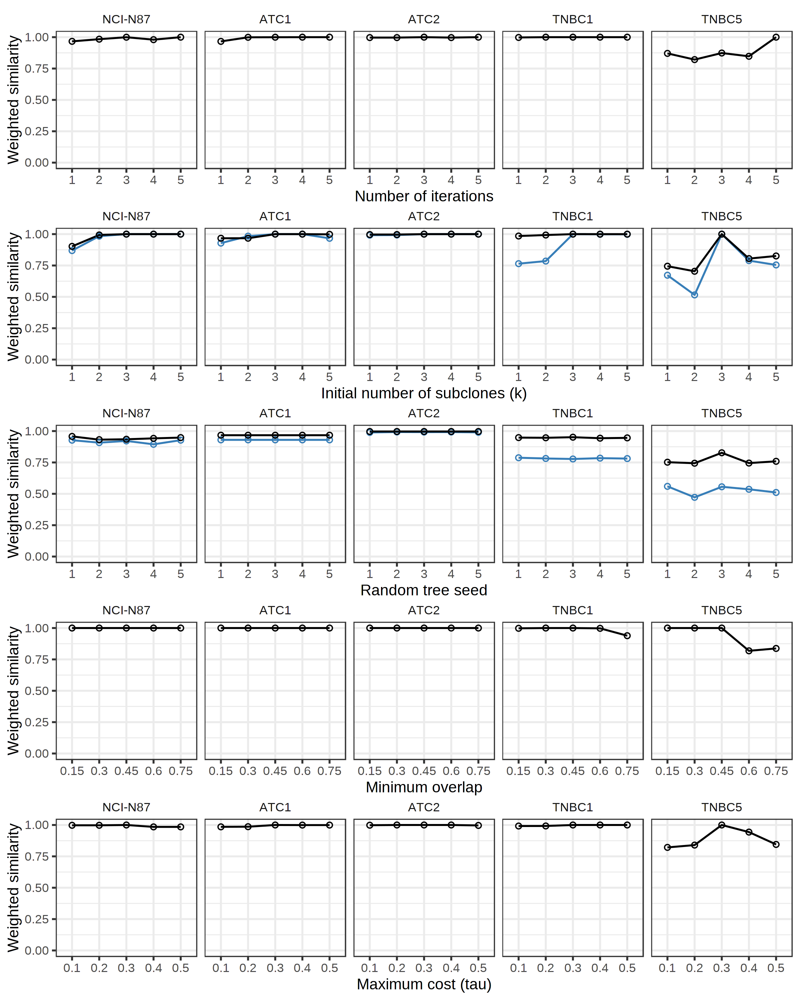

In [196]:
param_titles = c('k' = 'Initial number of subclones (k)', 'tau' = 'Maximum cost (tau)', 'overlap' = 'Minimum overlap',
                 'iter' = 'Number of iterations', 'random' = 'Random tree seed')

metric_titles = c('rand' = 'Rand index', 'consensus' = 'Jaccard similarity', 'subclone' = 'Weighted similarity')

for (metric in 'subclone') {
    
    p = lapply(
        c('iter', 'k', 'random', 'overlap', 'tau'),
        function(param) {

            scores = get(glue('{param}_scores'))

            if (!'iter' %in% colnames(scores)) {
                scores$iter = '2' 
            }

            scores %>% 
                filter(metric == UQ(metric)) %>%
                mutate(sample = str_remove(sample, '_subsampled')) %>%
                mutate(sample = factor(sample, c('NCI-N87', 'ATC1', 'ATC2', 'TNBC1', 'TNBC5'))) %>%
                ggplot(
                    aes(x = value, y = score, group = iter, color = iter)
                ) +
                geom_line(linetype = 'solid') +
                geom_point(pch = 21) +
                theme_bw() +
                scale_color_manual(values = c('2' = 'black', '1' = pal[2])) +
                facet_wrap(~sample, scale = 'free_x', nrow = 1) +
                ylim(0,1) +
                ylab(metric_titles[metric]) +
                theme(
                    strip.background = element_blank(),
                    legend.position = 'none',
                    plot.margin = margin(t = 0, 0, b = 0, 0, unit = 'mm')
                ) +
                xlab(param_titles[param])

    }) %>%
    wrap_plots(ncol = 1)
    
    do_plot(p, glue('{metric}_stability'), 8, 10)
    
}